# ERA5 Lifecycle Analysis

# Import packages

In [35]:
%load_ext autoreload
%autoreload 2
import xarray as xr
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.path as mpath
import matplotlib.cm as cm
import matplotlib.patches as mpatches
from matplotlib.patches import Rectangle
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import numpy as np
import pandas as pd
import scipy
import datetime
import cartopy
import cartopy.feature as cfeature
from metpy.units import units
import cartopy.crs as ccrs
import pickle
import glob
import subprocess
import dask
from joblib import Parallel, delayed
from geopy.distance import distance  
from cartopy.util import add_cyclic_point
import pyproj
from pyproj import Geod
from enum import Enum

import concurrent.futures

### Load MOAAP functions
import sys
sys.path.append('/work/aa0049/a271122/MOAAP/MOAAP/')
from src.utils import *
from src.Corrections import * 
from src.Enumerations import Month, Season, Experiments, Domains
from src.xarray_util import create_obj_from_dict,  ObjectContainer,  load_tracking_objects
from src.plot_funcs import plot_contourf_rotated_grid #, plot_unstructured_rotated_grid

from src.GridPoints import Domain
import cmocean
import os
from moviepy.video.io.ImageSequenceClip import ImageSequenceClip


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [36]:
%reload_ext autoreload
## Load my functions
from ERA5_utils import *

In [3]:
dask.config.set(**{'array.slicing.split_large_chunks': True})

In [4]:
plt.rcdefaults()

In [4]:
#plt.rcParams.update({
#    'axes.titlesize': 13,        # Title size
#    'axes.labelsize': 12,         # Axis label size
#    'lines.linewidth': 2,         # Line width
#    'lines.markersize': 7,       # Marker size for lines
#    'xtick.labelsize': 14,        # X-tick label size
#    'ytick.labelsize': 14         # Y-tick label size
#})

In [5]:
ERA5_clim_path='/work/aa0049/a271122/ERA5'

In [6]:
def preprocess(ds):
    ds = ds.sel(lat=slice(30, None))
    ds = ds.sel(time=slice("1979-01-01", "2022-12-31"))
    return ds


# Define global variables

In [7]:
# Extract the rotated coordinate system from example file
ds=xr.open_dataset('/work/aa0049/a271041/spice-v2.1/chain/work/run_era5_polarres_wp3_hindcast2/post/yearly/T_2M/T_2M_2020010100-2020123123.ncz')

crs_rot = ccrs.RotatedPole(pole_longitude=ds.rotated_pole.attrs['grid_north_pole_longitude'],\
                           pole_latitude=ds.rotated_pole.attrs['grid_north_pole_latitude'])

In [8]:
class Domains(Enum):
    NORTH_ATLANTIC_JLa = Domain(north=80, south=67, east=60, west=-30)
    BEAUFORT_SIBERIAN_JLa = Domain(north=80, south=70, east=-120, west=120)
    CENTRAL_ARCTIC_JLa = Domain(north=90, south=80, east=180, west=-180)


gridspacing=0.75
lat=np.arange(-90, 90+gridspacing,gridspacing)
lon=np.arange(-180, 180+gridspacing,gridspacing)
ds_dummy = xr.Dataset({"dummy": (("lat", "lon"), np.ones([len(lat), len(lon)]))},coords={"lon": lon,"lat": lat})
dd=ds_dummy.copy()

mask_domain_CentralArctic=dd.dummy.where(dd.lat>80).notnull()
mask_domain_NorthAtlantic=dd.dummy.where((dd.lat<=80) & (dd.lat>67) & (dd.lon>-30) & (dd.lon<60)).notnull()
mask_domain_BeaufortSiberianSea1=dd.dummy.where((dd.lat<=80) & (dd.lat>70) & (dd.lon>120)).notnull()
mask_domain_BeaufortSiberianSea2=dd.dummy.where((dd.lat<=80) & (dd.lat>70) & (dd.lon<-120)).notnull()

mask_domain_BeaufortSiberianSea = mask_domain_BeaufortSiberianSea1 | mask_domain_BeaufortSiberianSea2

mask_domains = {
    "CentralArctic": {"mask": mask_domain_CentralArctic, "color": 'r',"north":90,"south":80,"east":180,"west":-180},
    "NorthAtlantic": {"mask": mask_domain_NorthAtlantic, "color": 'b',"north":80,"south":67,"east":60,"west":-30},
    "BeaufortSiberianSea": {"mask": mask_domain_BeaufortSiberianSea, "color": "gold","north":80,"south":70,"east":120,"west":-120},
}


domains = ["NorthAtlantic","CentralArctic","BeaufortSiberianSea"]

# Load Objects

In [40]:
with open('/work/aa0238/a271093/results/MOAAP/IVT_Tracking/ERA5_ICON_remapped_3x/Object_container_1979-2022_withClusters.pkl', 'rb') as f:
    objs = pickle.load(f)

In [73]:
with open('/work/aa0049/a271122/MOAAP/IVT_Tracking/ERA5/Objects_transarctic_atlantic_ERA5.pkl', 'rb') as f:
   objs_final = pickle.load(f)

In [ ]:
#Load the objects in the Object container 1979-2022 
#objs = load_tracking_objects(
#         input_path = Experiments.ERA5.value.IVTobj_out_path,
#         input_file_name_temp = 'MOAPP_ERA5_100and85ERA5perc_remapped_3x',
#         type_ = 'IVT', 
#         first_year = 1979,
#         last_year  = 2022,
#         load_clusters = True,
#         load_coordinates=True,
#         exp=Experiments.ERA5.value)

In [11]:
df_objs=define_df_objs(objs)

In [12]:
df_objs

,id,color
0,1,"(0.2235294117647059, 0.23137254901960785, 0.47..."
1,2,"(0.2235294117647059, 0.23137254901960785, 0.47..."
2,3,"(0.2235294117647059, 0.23137254901960785, 0.47..."
3,4,"(0.2235294117647059, 0.23137254901960785, 0.47..."
4,5,"(0.2235294117647059, 0.23137254901960785, 0.47..."
...,...,...
99783,426438,"(0.8705882352941177, 0.6196078431372549, 0.839..."
99784,426439,"(0.8705882352941177, 0.6196078431372549, 0.839..."
99785,426440,"(0.8705882352941177, 0.6196078431372549, 0.839..."
99786,426441,"(0.8705882352941177, 0.6196078431372549, 0.839..."


## Select Objects with respect to season and/or sector

In [15]:
objs_sel, ids_sel = sel_objs(objs,season='DJF')

## Extract Rotated Coordinates and Transform Coordinates

In [16]:
objs_sel_tc = extract_and_transform_rot_coords(objs_sel)

In [17]:
len(objs_sel)

17

In [ ]:
## Extract times in which track is within domains
#Only select objects that go from the Atlantic towards the Pacific region

In [18]:
objs_final = []
for nr in range(len(objs_sel)):
    NA_time=extract_domain_times(objs_sel[nr],80,67,60,-30)
    BS_time=extract_domain_times(objs_sel[nr],80,70,120,-120,True)
    CA_time=extract_domain_times(objs_sel[nr],90,80,180,-180)

    if NA_time[0] < BS_time[0] and NA_time[0] < CA_time[0] and CA_time[0] < BS_time[0]:
        objs_final.append(objs_sel[nr])

len(objs_final)

13

In [21]:
for i in range(0,13): 
    print(objs_final[i].id_.values)

40554
56275
110498
120433
220464
236303
260541
306324
320482
330480
350573
376396
390547


In [23]:
# Select all wintertime objects
objs_sel_all, ids_sel_all  = sel_all_objects(objs,'DJF')

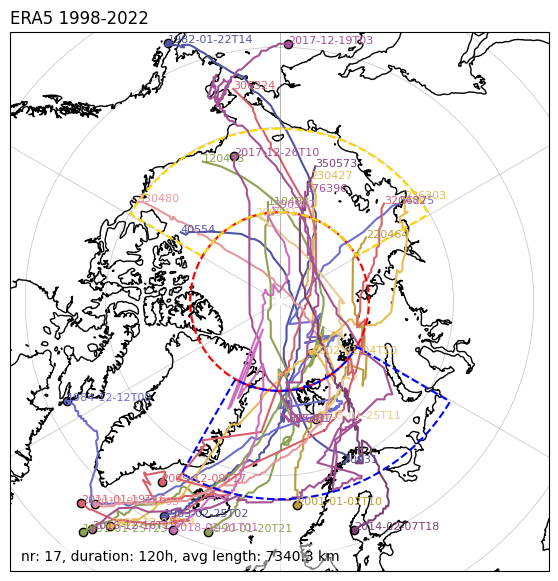

In [36]:
plot_tracks_2(objs_sel,df_objs)x

In [37]:
for i in range(len(objs_final)):
    track=objs_final[i].track.values
    
    track_lats = np.array([x.lat for x in track])
    track_lons = np.array([x.lon for x in track]) 
    print(str(objs_final[i]['times'][0].values.astype('datetime64[h]')))

1983-02-25T02
1984-12-12T00
1990-01-20T21
1991-01-25T23
2001-01-02T10
2002-12-04T14
2005-01-25T11
2009-12-09T17
2011-01-19T16
2012-01-12T03
2014-02-07T18
2016-12-16T19
2018-02-21T01


### PlateCarree Projection

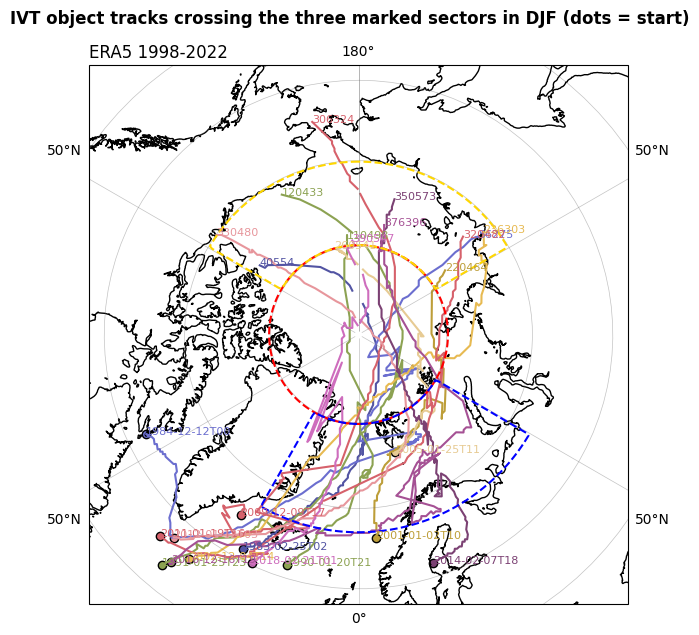

In [34]:
plot_tracks_PC(objs_final,df_objs)

## Select time chunks

In [13]:
#Select all dates in which an event appeared 
objs_times=[ds.times for ds in objs_final]

#Combine all dates in a data array 
objs_all_times = xr.concat(objs_times, dim='times').sortby('times').drop_duplicates(dim='times')

#Select all dates in which objects are in specific domains 
NA_combined_times, CA_combined_times, BS_combined_times = combine_times(objs_final)

In [14]:
month_day = get_month_day(objs_all_times)

In [15]:
NA_month_day, CA_month_day, BS_month_day = get_calendar_days(NA_combined_times, CA_combined_times,BS_combined_times)

#### sic

In [16]:
# Sea Ice Fraction -> fixed

In [56]:
ds_sic = xr.open_mfdataset("/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/mon/seaIce/sic/r1i1p1/sic_OImon_reanalysis_era5_r1i1p1_*.nc")
ds_sic = ds_sic.sel(time=slice("1979-01-01", "2022-12-31"))
ds_sic_DJF = ds_sic.sel(time=ds_sic.sic.time.dt.month.isin([12,1,2])).mean(dim='time')

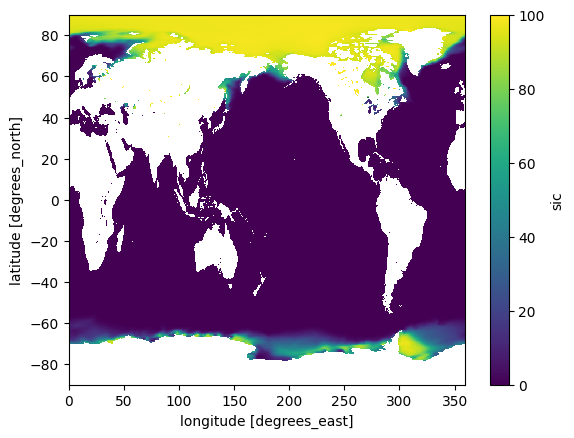

In [57]:
ds_sic_DJF.sic.plot()

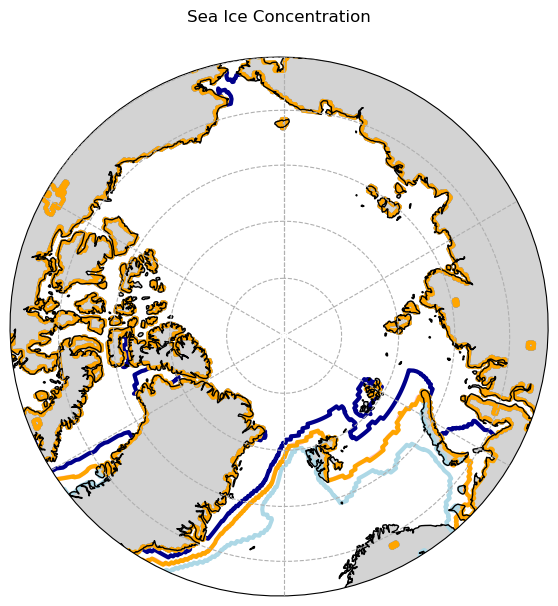

In [94]:
fig, ax = plt.subplots(1,1,figsize=(7,7),subplot_kw={'projection': ccrs.Orthographic(0,90)})

#ds_sic_DJF.sic.plot(ax=ax, transform = ccrs.PlateCarree(),cmap='Blues')
(ds_sic_DJF.sic>85).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='darkblue',linewidths=3)
(ds_sic_DJF.sic>15).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='lightblue',linewidths=3)
ds_sic_DJF.sic.plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='pink',linewidths=3)
(ds_sic_DJF.sic>50).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='orange',linewidths=3)

#ds_sic_DJF.sic.plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='pink',linewidths=3)

ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
ax.gridlines(linestyle='--',zorder=3)
ax.coastlines(zorder=2)
ax.add_feature(cartopy.feature.LAND, color='lightgray',zorder=0, edgecolor='None') 

    
center, radius = [0.5, 0.5], 0.5
circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)), np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
ax.set_boundary(circle, transform = ax.transAxes)
ax.set_title("Sea Ice Concentration",y=1.05)

plt.show()

In [ ]:
(sea_ice_edge>0.85)

##### daily sic 

In [72]:
ds_sic_daily = xr.open_mfdataset('/work/aa0049/a271122/ERA5/031/1D/E5sf00_1D_*.nc',combine="by_coords",parallel=True, chunks={"time":10})

# MOAAP Objects

In [24]:
#Open moaap objects 
ds_moaap = xr.open_mfdataset('/work/aa0238/a271093/results/MOAAP/IVT_Tracking/ERA5_ICON_remapped_3x/ObjectMasks_MOAPP_ERA5_100and85controlperc_remapped_3x_*_corrected.nc',chunks={'time': 10})

# Extract 2D latitude and longitude values
lat_tmp = ds_moaap.rlat.isel(time=0,x=0, yc=0, xc=0).values  # 2D latitude array
lon_tmp = ds_moaap.rlon.isel(time=0,y=0, yc=0, xc=0).values  # 2D longitude array

# Drop original variables and assignlat/lon as coordinates
ds_moaap = ds_moaap.drop(['rlat', 'rlon']) \
                   .rename_dims({'y': 'rlat', 'x': 'rlon'}) \
                   .assign_coords(rlat=('rlat', lat_tmp), 
                                  rlon=('rlon', lon_tmp))

ds_moaap = ds_moaap.isel(yc=0, xc=0).squeeze()



In [25]:
ds_moaap_DJF = ds_moaap.where(ds_moaap['time'].dt.month.isin([12, 1, 2]), drop=True)

In [ ]:
all_times_np = np.array(objs_all_times, dtype='datetime64[ns]')

# Select only matching times
ds_moaap_DJF_filtered = ds_moaap_DJF.sel(time=ds_moaap_DJF.time[np.isin(ds_moaap_DJF.time.values, all_times_np)])


### Animation

In [51]:

vmin_vmax_dict = {
    'zg': (-120, 120),
    'tas': (-15, 15),
    'pr': (-0.8, 0.8),
    'hcc': (-20, 20),
    'mcc': (-20, 20),
    'lcc': (-20, 20),
    'rlds':(-70, 70),
    'hfls':(-65, 65),
    'hfss':(-65, 65),
    'sic': (-80, 80),
    'prw': (-8,8),
    'sfcWind':(-10,10),
    'clwvi':(-0.2,0.2),
    'clivi':(-0.2,0.2)
    
}



#### Plots WAIs

In [ ]:
ds_wind_u = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/ua/r1i1p1-085000Pa/ua_1hr_reanalysis_era5_r1i1p1-085000Pa_*.nc', chunks={"time":10})
ds_wind_v = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/va/r1i1p1-085000Pa/va_1hr_reanalysis_era5_r1i1p1-085000Pa_*.nc', chunks={"time":10})

In [26]:
ds_zg = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/zg/r1i1p1-085000Pa/zg_1hr_reanalysis_era5_r1i1p1-085000Pa_*.nc', chunks={"time":10})#,preprocess=preprocess)

In [27]:

ds_tas=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/tas/r1i1p1/tas_1hr_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})
ds_rlds=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/rlds/r1i1p1/rlds_1hr_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})
ds_hfls=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hfls/r1i1p1/hfls_1hr_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})
ds_hfss=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hfss/r1i1p1/hfss_1hr_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})

In [28]:
ds_prw = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/prw/r1i1p1/prw_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10})
ds_sfcWind = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/sfcWind/r1i1p1/sfcWind_1hr_reanalysis_era5_r1i1p1_*.nc', chunks={"time":10})

In [101]:
ds_pr = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/pr/r1i1p1/pr_1hr_reanalysis_era5_r1i1p1*.nc', chunks={"time":10})#,preprocess=preprocess)
ds_hcc=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/hcc/r1i1p1/hcc_1hr-cf_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})
ds_mcc=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/mcc/r1i1p1/mcc_1hr-cf_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})
ds_lcc=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/lcc/r1i1p1/lcc_1hr-cf_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})

In [102]:
ds_clivi=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/clivi/r1i1p1/clivi_1hr_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})

In [103]:
ds_clwvi=xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/atmos/clwvi/r1i1p1/clwvi_1hr_reanalysis_era5_r1i1p1*.nc',chunks={"time":10})

In [29]:
ds_sic = xr.open_mfdataset('/work/bm1159/XCES/data4xces/reanalysis/reanalysis/ECMWF/IFS/ERA5/1hr/seaIce/sic/r1i1p1/sic_1hr_reanalysis_era5_r1i1p1_2012*.nc',chunks={"time":10})

In [30]:
ds_sic_DJF = ds_sic.sel(time=ds_sic.sic.time.dt.month.isin([12,1,2])).mean(dim='time')

In [42]:
df_objs=define_df_objs(objs)

In [ ]:
objs_plot_ids = [objs_final[2]['id_'].item()]#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

for tt in objs_plot_times[::6]:
    clim_moaap_plot(ds_tas,tt,ds_moaap,df_objs,objs_plot_ids,objs,'tas','tas',cmap='RdBu_r',save_figs=False,show_figs=True)

In [ ]:
## Example: plot one object (

objs_plot_ids = [objs_final[2]['id_'].item()]#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

for tt in objs_plot_times[::6]:

    moaap_object_plot(tt,ds_moaap,df_objs,objs_plot_ids,objs,save_figs=False,show_figs=True)

In [ ]:
objs_plot_ids = [objs_final[4]['id_'].item()]#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')


plot_subplot_anomalies_new(
    objs_plot_times[-5],
    dataset = [ds_moaap,ds_zg,ds_tas,ds_rlds,ds_hfls,ds_hfss],
    variables=['IVT', 'zg', 'tas', 'rlds', 'hfls', 'hfss'],
    variable_names=['Integrated Vapor Transport', '850 hPa Geopotential Height \n','Near-Surface Temperature \n', 'Surface Downward Longwelling \n Radiation', 'Surface Latent Heat Flux \n ', 'Surface Sensible Heat Flux \n'],
    variable_cmaps=['Blues', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs=objs,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour = var_anom_zg,
    mask_domains=mask_domains,
    savefig = False
)

In [ ]:
for i in range(4,13): 
    objs_plot_ids = [objs_final[i]['id_'].item()]#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
    # MOSAiC 2020-04 cases: ['1220826','1220835']
    
    objs_plot_times = xr.concat(
        [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
        dim='times').sortby('times').drop_duplicates(dim='times')
    
    for tt in objs_plot_times[::6]:
    
        plot_subplot_anomalies(
            tt,
            dataset = [ds_moaap,ds_zg,ds_tas,ds_rlds,ds_hfls,ds_hfss],
            variables=['IVT', 'zg', 'tas', 'rlds', 'hfls', 'hfss'],
            variable_names=['Integrated Vapor Transport', '850 hPa Geopotential Height \n','Near-Surface Temperature \n', 'Surface Downward Longwelling \n Radiation', 'Surface Latent Heat Flux \n ', 'Surface Sensible Heat Flux \n'],
            variable_cmaps=['Blues', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r'],
            ds_moaap=ds_moaap,
            df_objs=df_objs,
            objs=objs,
            objs_plot_ids=objs_plot_ids,
            crs_rot=crs_rot,
            ds_contour=ds_zg,
            mask_domains=mask_domains,
            savefig = True
        )

#### Case Study

In [64]:
objs_plot_ids = [objs_final[9]['id_'].item()]
objs_plot_ids

['330480']

In [65]:

objs_plot_ids = [objs_final[9]['id_'].item()]

objs_plot_times = xr.concat(
    [obj.times for obj in objs_final if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')


In [66]:
#create GPH contour lines
zg_clim_DJF = xr.open_dataset('/work/aa0049/a271122/ERA5/zg/clim/zg_clim_day_DJF.nc')

tt = objs_plot_times[95]
#Compute anomaly
tt_dt = pd.to_datetime(tt.values)
month = tt_dt.month
day = tt_dt.day
month_day_str = f"{month:02d}-{day:02d}"


var_tot = ds_zg.sel(time=tt, method='nearest')


var_clim = zg_clim_DJF['zg'].sel(time=zg_clim_DJF.time.dt.strftime('%m-%d') == month_day_str)

var_anom_zg = var_tot.zg - var_clim
var_anom_zg = var_anom_zg.assign_coords(lon=((var_anom_zg.lon + 180) % 360) - 180).sortby(['lat','lon']).squeeze()



In [ ]:

plot_subplot_anomalies_new(
    objs_plot_times[95],
    dataset = [ds_moaap,ds_zg,ds_tas,ds_rlds,ds_hfls,ds_hfss],
    variables=['IVT', 'zg', 'tas', 'rlds', 'hfls', 'hfss'],
    variable_names=['Integrated Vapor Transport', '850 hPa Geopotential Height \n','Near-Surface Temperature \n', 'Surface Longwave Downward \n Radiation', 'Surface Latent Heat Flux \n ', 'Surface Sensible Heat Flux \n'],
    variable_cmaps=['Blues', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs=objs,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour= var_anom_zg,
    mask_domains=mask_domains,
    savefig = False
)

In [ ]:
vmin_vmax_dict = {
    'zg': (-120, 120),
    'tas': (-15, 15),
    'pr': (-0.8, 0.8),
    'hcc': (0, 100),
    'mcc': (0, 100),
    'lcc': (0, 100),
    'rlds':(-65, 65),
    'hfls':(-65, 65),
    'hfss':(-65, 65),
    'sic': (-80, 80),
    'prw':(-12,12),
    'sfcWind':(-13,13),
    'clwvi':(-0.2,0.2),
    'clivi':(-0.2,0.2)
}


In [69]:
print('hi')

hi


In [70]:
df_objs=define_df_objs(objs_final)

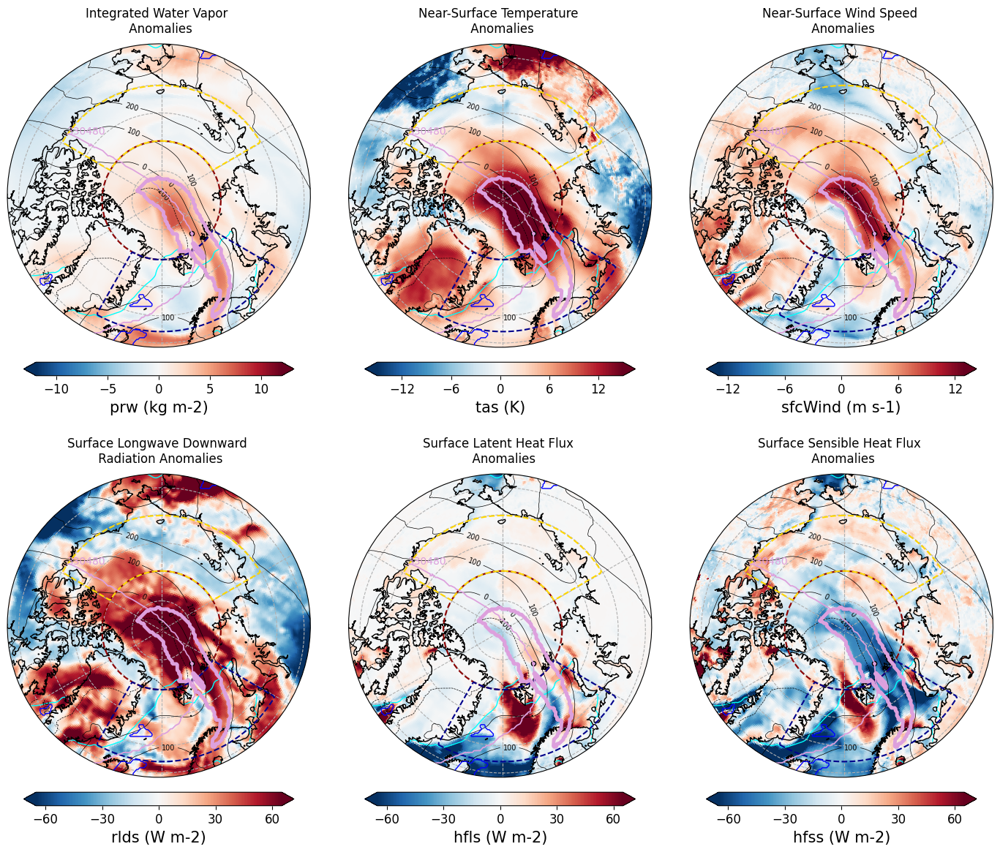

In [77]:
plot_subplot_anomalies(
    objs_plot_times[95],
    dataset = [ds_prw,ds_tas,ds_sfcWind,ds_rlds,ds_hfls,ds_hfss],
    variables=['prw', 'tas','sfcWind', 'rlds', 'hfls', 'hfss'],
    variable_names=['Integrated Water Vapor \n','Near-Surface Temperature \n', 'Near-Surface Wind Speed \n','Surface Longwave Downward \n Radiation', 'Surface Latent Heat Flux \n ', 'Surface Sensible Heat Flux \n'],
    variable_cmaps=['RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs_final=objs_final,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour = var_anom_zg, 
    mask_domains=mask_domains,
    savefig = False
)

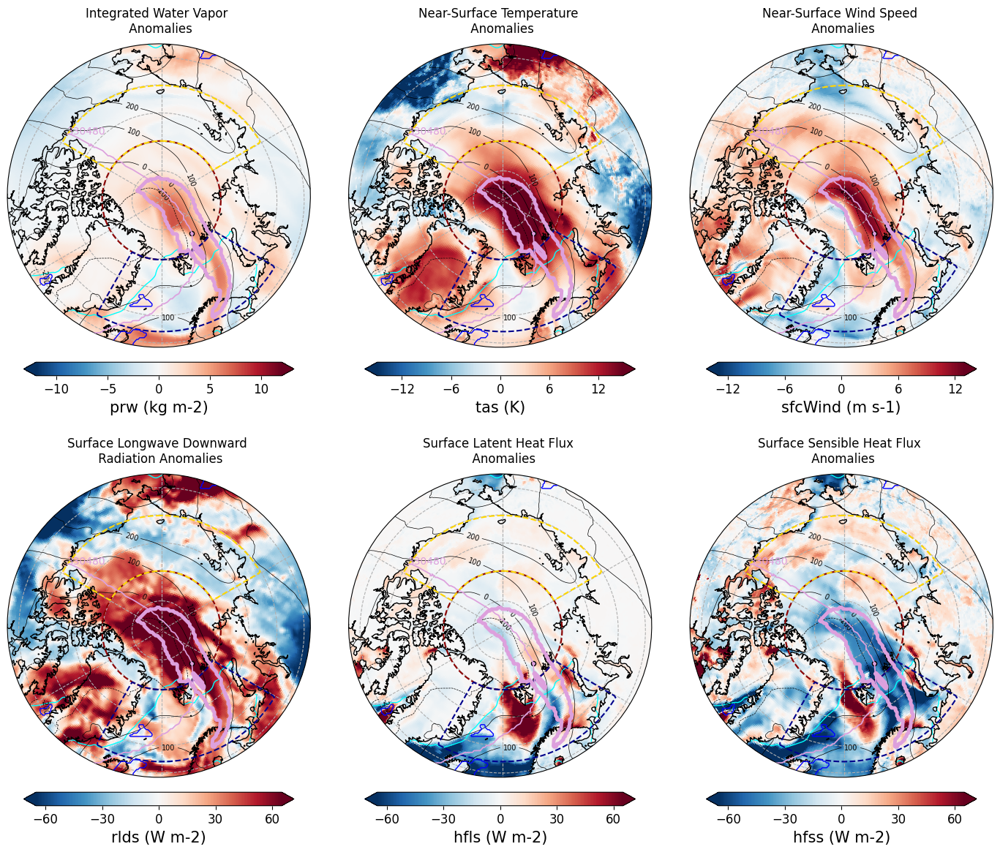

In [79]:
plot_subplot_anomalies(
    objs_plot_times[95],
    dataset = [ds_prw,ds_tas,ds_sfcWind,ds_rlds,ds_hfls,ds_hfss],
    variables=['prw', 'tas','sfcWind', 'rlds', 'hfls', 'hfss'],
    variable_names=['Integrated Water Vapor \n','Near-Surface Temperature \n', 'Near-Surface Wind Speed \n','Surface Longwave Downward \n Radiation', 'Surface Latent Heat Flux \n ', 'Surface Sensible Heat Flux \n'],
    variable_cmaps=['RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r', 'RdBu_r'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs_final=objs_final,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour = var_anom_zg, 
    mask_domains=mask_domains,
    savefig = True
)

In [ ]:
#Water Cycle
cmap = cmocean.cm.tarn
newcmap = cmocean.tools.crop_by_percent(cmap, 30, which='both', N=None)
plot_subplot_anomalies_noIVT(
    objs_plot_times[95],
    dataset = [ds_pr,ds_clwvi,ds_clivi,ds_hcc,ds_mcc,ds_lcc],
    variables=['pr', 'clwvi','clivi', 'hcc', 'mcc', 'lcc'],
    variable_names=['Precipitation','Liquid Water Path','Ice Water Path', 'High-Level \n Cloud Cover', 'Middle-Level \n Cloud Cover', 'Low-Level \n Cloud Cover'],
    variable_cmaps=['cmo.tarn', 'cmo.tarn', 'cmo.tarn', 'Blues', 'Blues', 'Blues'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs_final=objs,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour=var_anom_zg,
    mask_domains=mask_domains,
    savefig = False
)

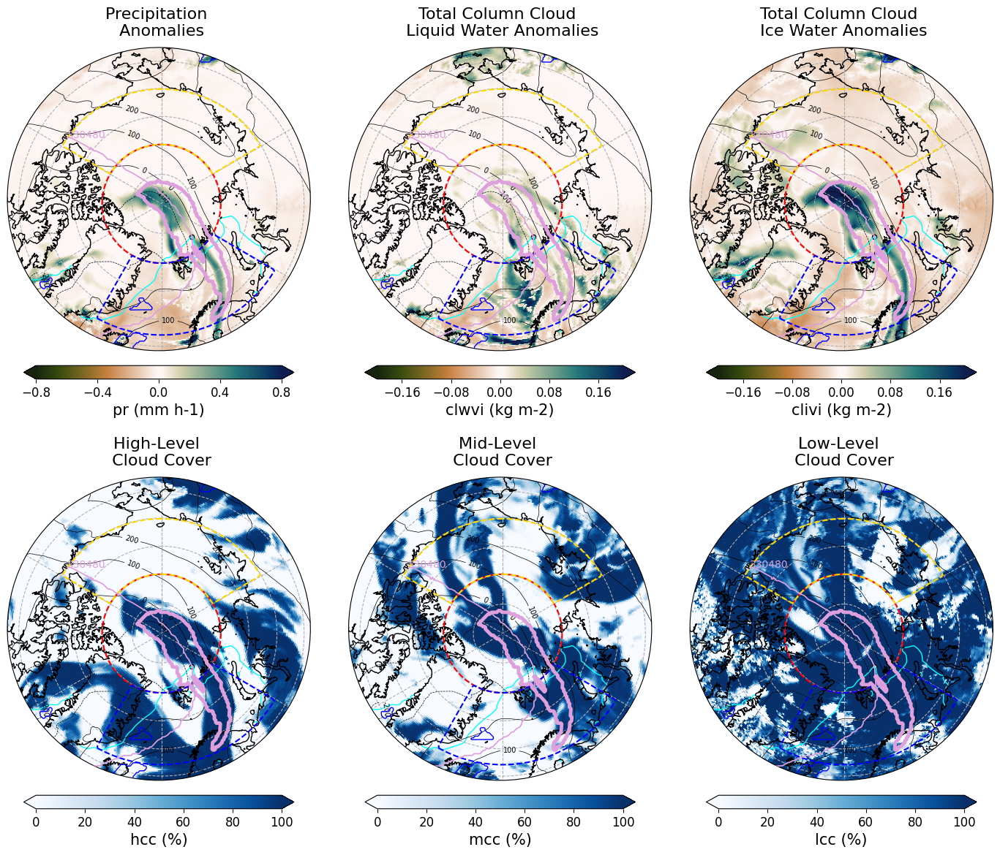

In [146]:
tt = objs_plot_times[95]
dataset = [ds_pr,ds_clwvi,ds_clivi,ds_hcc,ds_mcc,ds_lcc]
variables=['pr', 'clwvi','clivi', 'hcc', 'mcc', 'lcc']
variable_names=['Precipitation \n','Total Column Cloud \n Liquid Water','Total Column Cloud \n Ice Water', 'High-Level \n Cloud Cover', 'Mid-Level \n Cloud Cover', 'Low-Level \n Cloud Cover']
variable_cmaps=['cmo.tarn', 'cmo.tarn', 'cmo.tarn', 'Blues', 'Blues', 'Blues']
ds_contour=var_anom_zg
savefig = True

fig, axs = plt.subplots(2, 3, figsize=(18, 14),
                        subplot_kw={'projection': ccrs.Orthographic(0, 90)})
axs = axs.flatten()

vmin_vmax_dict = {
    'zg': (-120, 120),
    'tas': (-15, 15),
    'pr': (-0.8, 0.8),
    'hcc': (0, 100),
    'mcc': (0, 100),
    'lcc': (0, 100),
    'rlds':(-65, 65),
    'hfls':(-65, 65),
    'hfss':(-65, 65),
    'sic': (-80, 80),
    'clwvi':(-0.2,0.2),
    'clivi':(-0.2,0.2)
}



for i in range(6):
    ax = axs[i]
    ax.clear()
    ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
    ax.gridlines(linestyle='--', zorder=3)
    ax.coastlines(zorder=2)
    ax.add_feature(cartopy.feature.LAND, color='lightgray', alpha=1, zorder=0, edgecolor='black')
    #ax.add_feature(cartopy.feature.OCEAN, color='white', zorder=0, edgecolor='black')
    #fig.suptitle(' ',fontweight='bold',y=0.97) #,ha='right'
    #ax.set_title(f"{variable_names[i]} Anomalies", y=1.05)
    


    
    # Clip to circle
    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)),
                                   np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    #add GPH contour
    contour = ds_contour.plot.contour(levels=10,ax=ax,transform=ccrs.PlateCarree(),colors='k',linewidths=0.5)
    ax.clabel(contour, fmt='%1.0f', inline=True, fontsize=7)

    # Optional domain outlines
    if mask_domains:
        for domain_name, domain_data in mask_domains.items():
            domain_data["mask"].plot.contour(levels=1, colors=domain_data["color"],
                                             linewidths=1.5, linestyles='--',
                                             zorder=4, ax=ax, transform=ccrs.PlateCarree())


    if i<=2: 
   
        # Plot climate variable
        var = variables[i]
    
        # Default padding between colorbar and map
        vmin, vmax = vmin_vmax_dict.get(var, (None, None))
    
        ds = dataset[i]
        ds_clim = xr.open_dataset(f'{ERA5_clim_path}/{var}/clim/{var}_clim_day_DJF.nc',chunks={'time': 10})
    
        #Compute anomaly
        tt_dt = pd.to_datetime(tt.values)
        month = tt_dt.month
        day = tt_dt.day
        month_day_str = f"{month:02d}-{day:02d}"
    
        if var =='pr':
            var_tot = ds[var].sel(time=tt, method='nearest')*3600
    
            var_clim = ds_clim[var].sel(time=ds_clim.time.dt.strftime('%m-%d') == month_day_str)*3600
        else: 
            var_tot = ds[var].sel(time=tt, method='nearest')
    
            var_clim = ds_clim[var].sel(time=ds_clim.time.dt.strftime('%m-%d') == month_day_str)
            
        var_anom = var_tot - var_clim
        var_anom = var_anom.assign_coords(lon=((var_anom.lon + 180) % 360) - 180).sortby(['lat','lon'])
    
        var_anom_plot = var_anom.plot(ax=ax, cmap=variable_cmaps[i], transform=ccrs.PlateCarree(),vmin=vmin,vmax=vmax,add_colorbar=False)
    
        
        #ax.set_title(f"{variable_names[i]} Anomalies", y=1.05)

    else: 
        # Plot climate variable
        var = variables[i]
    
        # Default padding between colorbar and map
        vmin, vmax = vmin_vmax_dict.get(var, (None, None))
    
        ds = dataset[i]
       
        var_tot = ds[var].sel(time=tt, method='nearest').assign_coords(lon=((var_tot.lon + 180) % 360) - 180).sortby(['lat','lon'])
         
        var_anom_plot = var_tot.plot(ax=ax, cmap=variable_cmaps[i], transform=ccrs.PlateCarree(),vmin=vmin,vmax=vmax,add_colorbar=False)
    
        #ax.set_title(f"{variable_names[i]}", y=1.05)

    add_custom_colorbar(var_anom_plot, ax, ds, var)
    
    # Plot tracked objects
    ds_moaap_sel = ds_moaap.sel(time=tt, method='nearest').compute()
    obj_ids_tt = np.unique(ds_moaap_sel.IVT_Objects)
    obj_ids_tt = obj_ids_tt[obj_ids_tt != 0].astype(int)

    for obj_id in obj_ids_tt:
        if (df_objs['id'] == str(obj_id)).any():
            obj_color = 'plum' #df_objs[df_objs['id'] == str(obj_id)].color.item()
        else:
            obj_color = 'b'

        lw = 3.5 if str(obj_id) in objs_plot_ids else 1

        if str(obj_id) in objs_plot_ids:
            obj_idx = df_objs[df_objs['id'] == str(obj_id)].index.item()
            track = objs_final[obj_idx].track
            track_lats = np.array([x.lat for x in track.values])
            track_lons = np.array([x.lon for x in track.values])
            track_tt = track.sel(times=tt, method='nearest')
            ax.scatter(track_tt.item().lon, track_tt.item().lat, transform=crs_rot,
                       facecolor=[obj_color], edgecolor='k', s=20)
            ax.plot(track_lons, track_lats, color=obj_color, lw=1.25, transform=crs_rot, zorder=8)
            ax.text(track_lons[-1], track_lats[-1], obj_id, transform=crs_rot, color=obj_color, zorder=11)

        (ds_moaap_sel.IVT_Objects == obj_id).plot.contour(x='rlon', y='rlat', ax=ax, levels=1,
                                                          colors=[obj_color], linewidths=lw,
                                                          transform=crs_rot, zorder=10)

    #Add sea ice
    ds_sic_DJF.sic.plot.contour(levels=1, ax = ax, transform = ccrs.PlateCarree(), colors = 'cyan', linewidths = 1, linestyles = '-',zorder=1)

    if i <=2:
        ax.set_title(f"{variable_names[i]} Anomalies", y=1.07)
    else:
        ax.set_title(f"{variable_names[i]}", y=1.07)
        
plt.subplots_adjust(wspace=0.01)
    
if savefig==True:
    plt.savefig("/work/aa0049/a271122/scripts/ERA5/casestudy_pr.jpg",dpi=300,bbox_inches="tight")#,transparent=True)
    #plt.close(fig)
    
#plt.tight_layout()
plt.show()

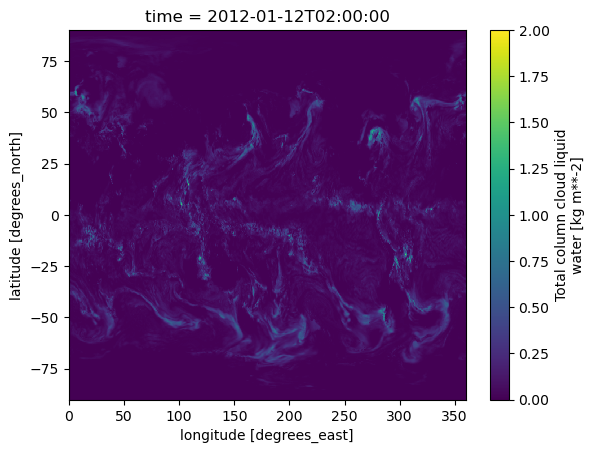

In [54]:
ds_era5_hourly.tclw.sel(time='2012-01-12T02:00:00').plot(vmin=0,vmax=2)

In [43]:
ds_hfss.hfls

<xarray.DataArray 'hfss' (time: 751673, lat: 640, lon: 1280)>
dask.array<concatenate, shape=(751673, 640, 1280), dtype=float32, chunksize=(10, 640, 1280), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 1940-01-01T07:00:00 ... 2025-09-30T23:00:00
  * lon      (lon) float64 0.0 0.2812 0.5625 0.8438 ... 358.9 359.2 359.4 359.7
  * lat      (lat) float64 -89.78 -89.51 -89.23 -88.95 ... 89.23 89.51 89.78
Attributes:
    standard_name:  surface_upward_sensible_heat_flux
    long_name:      Surface Upward Sensible Heat Flux
    units:          W m-2
    code:           146
    table:          128
    original_name:  var146

In [40]:
ds_hfls_sel = ds_hfls.hfls.sel(time=ds_hfls.hfls.time.dt.month.isin([12,1,2])).mean(dim='time')

In [48]:
ds_hfls_clim = xr.open_dataset(f"{ERA5_clim_path}/hfls/clim/hfls_clim_day_DJF.nc")

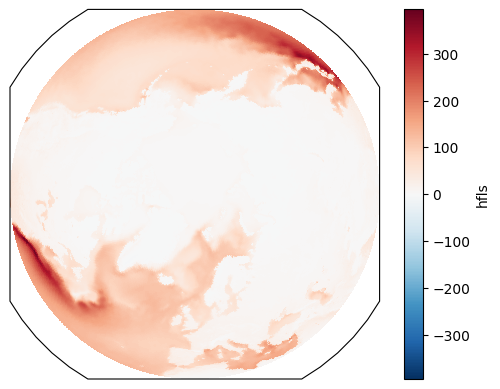

In [54]:
fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})


ds_hfls_clim.hfls.mean(dim='time').plot(ax=ax,transform=ccrs.PlateCarree())

In [55]:
ds_hfss_clim = xr.open_dataset(f"{ERA5_clim_path}/hfss/clim/hfss_clim_day_DJF.nc")

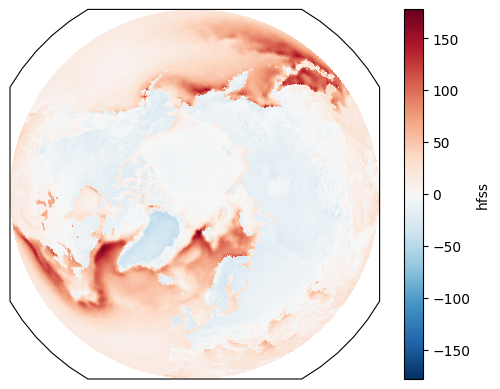

In [56]:
fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})


ds_hfss_clim.hfss.mean(dim='time').plot(ax=ax,transform=ccrs.PlateCarree())

In [57]:
ds_lcc_clim = xr.open_dataset(f"{ERA5_clim_path}/lcc/clim/lcc_clim_day_DJF.nc")

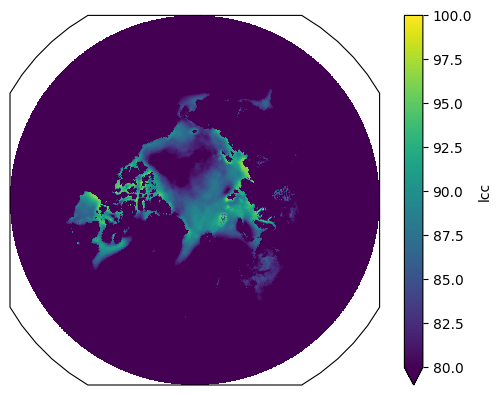

In [77]:
fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})


ds_lcc_clim.lcc.mean(dim='time').plot(ax=ax,transform=ccrs.PlateCarree(),vmin=80,vmax=100)

In [64]:
ds_hcc_clim = xr.open_dataset(f"{ERA5_clim_path}/hcc/clim/hcc_clim_day_DJF.nc")
ds_mcc_clim = xr.open_dataset(f"{ERA5_clim_path}/mcc/clim/mcc_clim_day_DJF.nc")

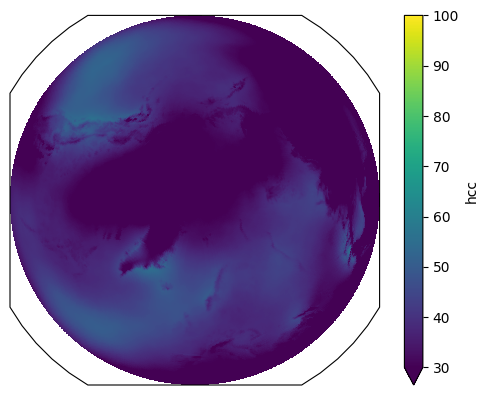

In [71]:
fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})


ds_hcc_clim.hcc.mean(dim='time').plot(ax=ax,transform=ccrs.PlateCarree(),vmin=30,vmax=100)

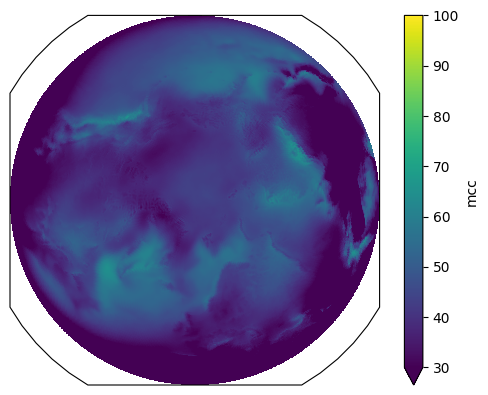

In [72]:
fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})


ds_mcc_clim.mcc.mean(dim='time').plot(ax=ax,transform=ccrs.PlateCarree(),vmin=30,vmax=100)

In [78]:
ds_pr_clim = xr.open_dataset(f"{ERA5_clim_path}/pr/clim/pr_clim_day_DJF.nc")

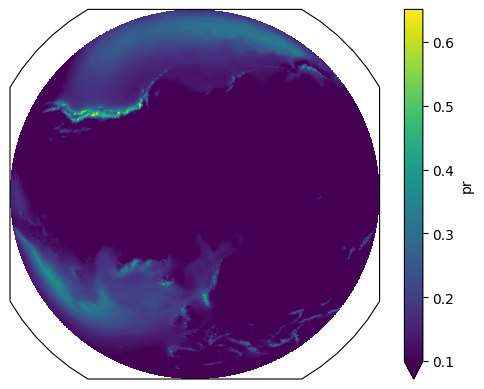

In [82]:
fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})


(ds_pr_clim.pr.sel().mean(dim='time')*3600).plot(ax=ax,transform=ccrs.PlateCarree(),vmin=0.1)

In [71]:
#Create wind speed and direction arrows
time_sel = '2012-01-16T02:00:00.000000000'
u = ds_wind_u.ua.sel(time=time_sel)
v = ds_wind_v.va.sel(time=time_sel)

lat = u.lat.values
lon = u.lon.values
lon2d, lat2d = np.meshgrid(lon, lat)
u_vals = u.values
v_vals = v.values

wind_speed = np.sqrt(u_vals**2 + v_vals**2)

# Step 1: Use a much coarser fixed step
step_lat = 10
step_lon = 12

u_sub = u_vals[::step_lat, ::step_lon]
v_sub = v_vals[::step_lat, ::step_lon]
lon_sub = lon2d[::step_lat, ::step_lon]
lat_sub = lat2d[::step_lat, ::step_lon]

# Step 2: Aggressive thinning at higher latitudes
mask = np.ones(u_sub.shape, dtype=bool)

for i, lat_val in enumerate(lat_sub[:, 0]):
    abs_lat = abs(lat_val)
    if abs_lat > 88:
        mask[i, :] = False  # Remove all arrows >88°
    elif abs_lat > 85:
        # Keep only every 3rd arrow
        mask[i, :] = False
        mask[i, ::3] = True
    elif abs_lat > 80:
        # Keep every 2nd arrow
        mask[i, ::2] = True
        mask[i, 1::2] = False

lon_plot = lon_sub[mask]
lat_plot = lat_sub[mask]
u_plot = u_sub[mask]
v_plot = v_sub[mask]

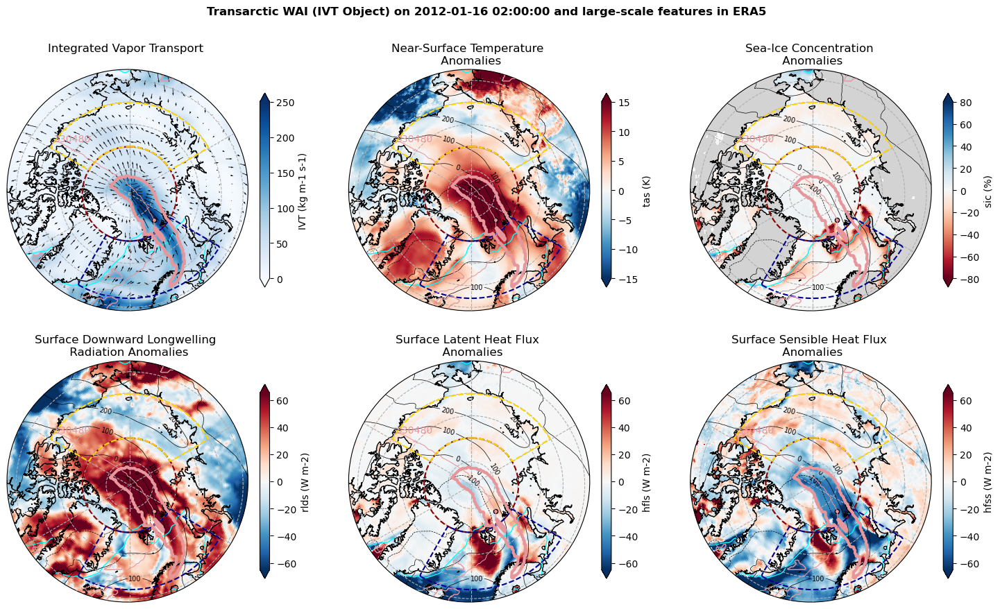

In [244]:

plot_subplot_anomalies_new(
    objs_plot_times[95],
    dataset = [ds_moaap,ds_tas,ds_sic,ds_rlds,ds_hfls,ds_hfss],
    variables=['IVT', 'tas','sic', 'rlds', 'hfls', 'hfss'],
    variable_names=['Integrated Vapor Transport','Near-Surface Temperature \n','Sea-Ice Concentration \n', 'Surface Downward Longwelling \n Radiation', 'Surface Latent Heat Flux \n ', 'Surface Sensible Heat Flux \n'],
    variable_cmaps=['Blues', 'RdBu_r', 'RdBu', 'RdBu_r', 'RdBu_r', 'RdBu_r'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs=objs,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour=var_anom_zg,
    mask_domains=mask_domains,
    savefig = True
)

In [87]:
cmap = cmocean.cm.tarn
newcmap = cmocean.tools.crop_by_percent(cmap, 30, which='both', N=None)

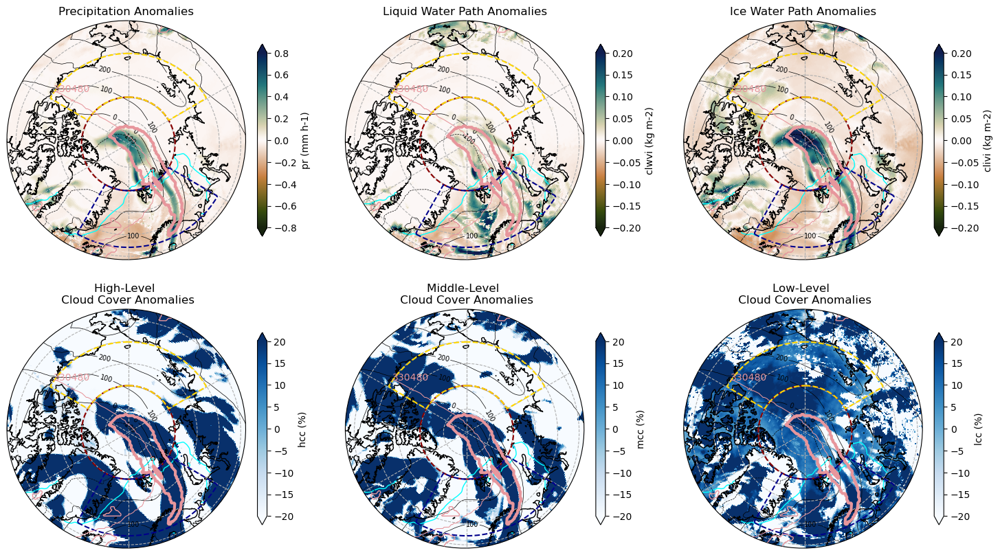

In [88]:
cmap = cmocean.cm.tarn
newcmap = cmocean.tools.crop_by_percent(cmap, 30, which='both', N=None)
plot_subplot_anomalies_noIVT(
    objs_plot_times[95],
    dataset = [ds_pr,ds_clwvi,ds_clivi,ds_hcc,ds_mcc,ds_lcc],
    variables=['pr', 'clwvi','clivi', 'hcc', 'mcc', 'lcc'],
    variable_names=['Precipitation','Liquid Water Path','Ice Water Path', 'High-Level \n Cloud Cover', 'Middle-Level \n Cloud Cover', 'Low-Level \n Cloud Cover'],
    variable_cmaps=['cmo.tarn', 'cmo.tarn', 'cmo.tarn', 'Blues', 'Blues', 'Blues'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs=objs,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour=var_anom_zg,
    mask_domains=mask_domains,
    savefig = True
)

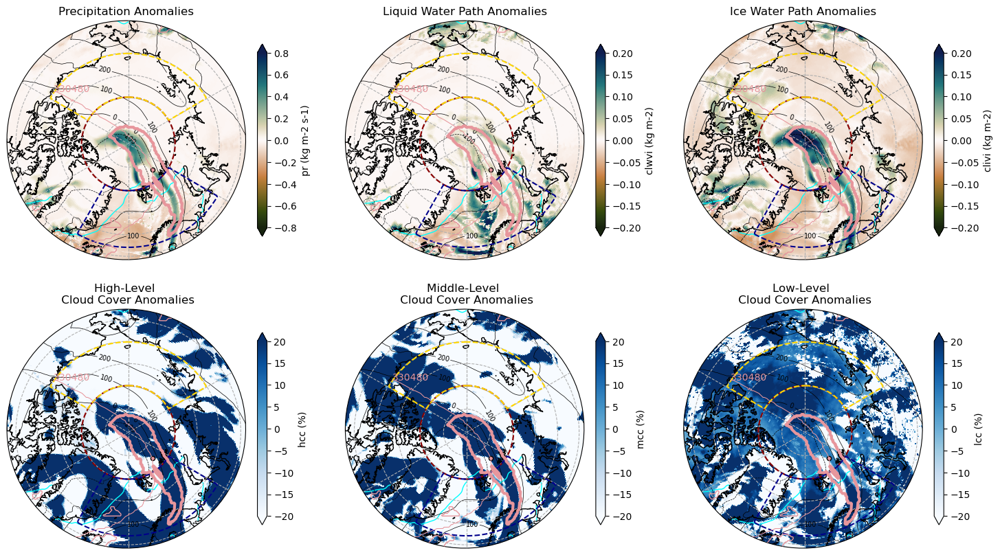

In [83]:

plot_subplot_anomalies_noIVT(
    objs_plot_times[95],
    dataset = [ds_pr,ds_clwvi,ds_clivi,ds_hcc,ds_mcc,ds_lcc],
    variables=['pr', 'clwvi','clivi', 'hcc', 'mcc', 'lcc'],
    variable_names=['Precipitation','Liquid Water Path','Ice Water Path', 'High-Level \n Cloud Cover', 'Middle-Level \n Cloud Cover', 'Low-Level \n Cloud Cover'],
    variable_cmaps=['cmo.tarn', 'cmo.tarn', 'cmo.tarn', 'Blues', 'Blues', 'Blues'],
    ds_moaap=ds_moaap,
    df_objs=df_objs,
    objs=objs,
    objs_plot_ids=objs_plot_ids,
    crs_rot=crs_rot,
    ds_contour=var_anom_zg,
    mask_domains=mask_domains,
    savefig = False
)

In [261]:
l = 1

In [167]:
wind_speed = np.sqrt(ds_wind_u.ua**2+ds_wind_v.va**2)

In [36]:
def rotate_vectors(lat, lon, U, V, source_crs=ccrs.PlateCarree(), target_crs=ccrs.PlateCarree()):
    xyz = target_crs.transform_points(source_crs, lon, lat)
    x, y = xyz[..., 0], xyz[..., 1]

    delta_lon = 0.01
    delta_lat = 0.01

    xyz_east = target_crs.transform_points(source_crs, lon + delta_lon, lat)
    dx_east = xyz_east[..., 0] - x
    dy_east = xyz_east[..., 1] - y

    xyz_north = target_crs.transform_points(source_crs, lon, lat + delta_lat)
    dx_north = xyz_north[..., 0] - x
    dy_north = xyz_north[..., 1] - y

    norm_e = np.hypot(dx_east, dy_east)
    e_x = dx_east / norm_e
    e_y = dy_east / norm_e

    norm_n = np.hypot(dx_north, dy_north)
    n_x = dx_north / norm_n
    n_y = dy_north / norm_n

    u_rot = U * e_x + V * n_x
    v_rot = U * e_y + V * n_y

    return x, y, u_rot, v_rot


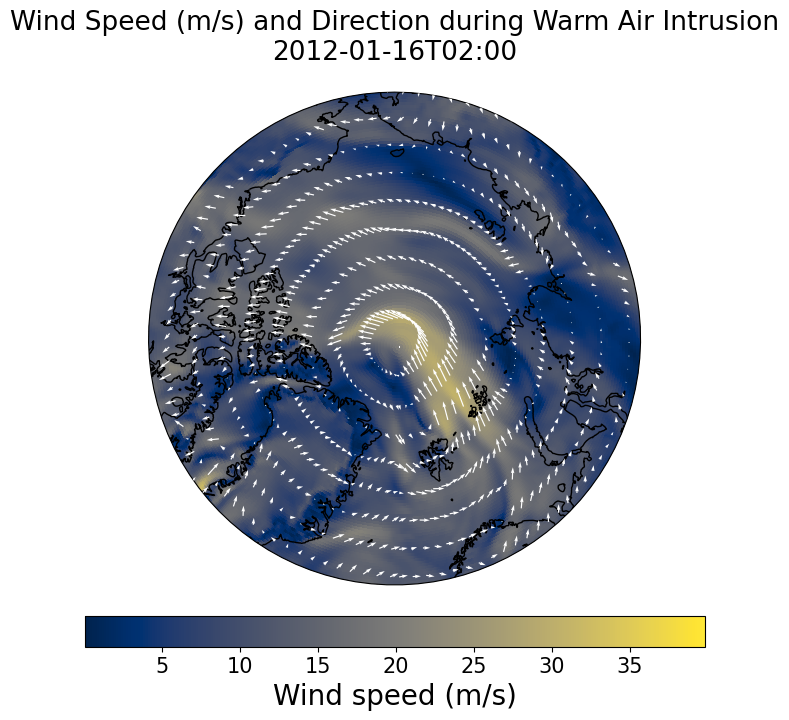

In [37]:
# --- 1. Select time and extract data ---
time_sel = '2012-01-16T02:00:00.000000000'
u = ds_wind_u.ua.sel(time=time_sel)
v = ds_wind_v.va.sel(time=time_sel)

lat = u.lat.values
lon = u.lon.values
lon2d, lat2d = np.meshgrid(lon, lat)
u_vals = u.values
v_vals = v.values

# --- 2. Compute wind speed ---
wind_speed = np.sqrt(u_vals**2 + v_vals**2)

# --- 3. Define subsampling steps ---
step_lat = 10
step_lon = 12

# --- 4. Rotate vectors into target projection ---
target_crs = ccrs.Orthographic(0, 90)

# Apply vector rotation
x, y, u_rot, v_rot = rotate_vectors(lat2d, lon2d, u_vals, v_vals, source_crs=ccrs.PlateCarree(), target_crs=target_crs)

# --- 5. Subsample rotated data and coordinates ---
x_sub = x[::step_lat, ::step_lon]
y_sub = y[::step_lat, ::step_lon]
u_rot_sub = u_rot[::step_lat, ::step_lon]
v_rot_sub = v_rot[::step_lat, ::step_lon]
lat_sub = lat2d[::step_lat, ::step_lon]

# --- 6. Latitude-dependent thinning ---
mask = np.ones(u_rot_sub.shape, dtype=bool)

for i, lat_val in enumerate(lat_sub[:, 0]):
    abs_lat = abs(lat_val)
    if abs_lat > 88:
        mask[i, :] = False
    elif abs_lat > 85:
        mask[i, :] = False
        mask[i, ::3] = True
    elif abs_lat > 80:
        mask[i, ::2] = True
        mask[i, 1::2] = False

# --- 7. Apply mask to rotated vectors and coordinates ---
x_plot = x_sub[mask]
y_plot = y_sub[mask]
u_plot = u_rot_sub[mask]
v_plot = v_rot_sub[mask]

# --- 8. Plotting ---
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': target_crs})

# Plot wind speed as colored field
cf = ax.pcolormesh(lon2d, lat2d, wind_speed, transform=ccrs.PlateCarree(),
                   cmap='cividis', shading='auto')

# Plot rotated wind vectors
ax.quiver(x_plot, y_plot, u_plot, v_plot, transform=target_crs, color='white', scale=700, zorder=3)

# Add map features
ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
ax.coastlines(zorder=2)
ax.add_feature(cfeature.LAND, color='lightgray', zorder=0, edgecolor='none')

# Set circular boundary for polar projection
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
circle = mpath.Path(np.column_stack([np.sin(theta), np.cos(theta)]) * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

# Title and colorbar
ax.set_title("Wind Speed (m/s) and Direction during Warm Air Intrusion\n2012-01-16T02:00", y=1.05)
plt.colorbar(cf, ax=ax, orientation='horizontal', pad=0.05, label="Wind speed (m/s)")

plt.show()


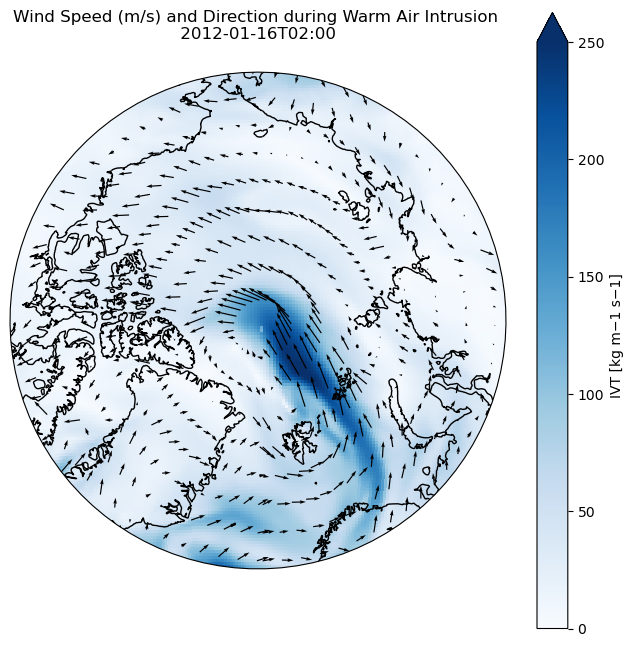

In [80]:
time_sel = '2012-01-16T02:00:00.000000000'
u = ds_wind_u.ua.sel(time=time_sel)
v = ds_wind_v.va.sel(time=time_sel)

lat = u.lat.values
lon = u.lon.values
lon2d, lat2d = np.meshgrid(lon, lat)
u_vals = u.values
v_vals = v.values

wind_speed = np.sqrt(u_vals**2 + v_vals**2)

# Step 1: Use a much coarser fixed step
step_lat = 10
step_lon = 17
# --- 4. Rotate vectors into target projection ---
target_crs = ccrs.Orthographic(0, 90)

# Apply vector rotation
x, y, u_rot, v_rot = rotate_vectors(lat2d, lon2d, u_vals, v_vals, source_crs=ccrs.PlateCarree(), target_crs=target_crs)

# --- 5. Subsample rotated data and coordinates ---
x_sub = x[::step_lat, ::step_lon]
y_sub = y[::step_lat, ::step_lon]
u_rot_sub = u_rot[::step_lat, ::step_lon]
v_rot_sub = v_rot[::step_lat, ::step_lon]
lat_sub = lat2d[::step_lat, ::step_lon]

# Step 2: Aggressive thinning at higher latitudes
mask = np.ones(u_rot_sub.shape, dtype=bool)

for i, lat_val in enumerate(lat_sub[:, 0]):
    abs_lat = abs(lat_val)
    if abs_lat > 88:
        mask[i, :] = False  # Remove all arrows >88°
    elif abs_lat > 85:
        # Keep only every 3rd arrow
        mask[i, :] = False
        mask[i, ::3] = True
    elif abs_lat > 80:
        # Keep every 2nd arrow
        mask[i, ::2] = True
        mask[i, 1::2] = False

x_plot = x_sub[mask]
y_plot = y_sub[mask]
u_plot = u_rot_sub[mask]
v_plot = v_rot_sub[mask]

fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': ccrs.Orthographic(0, 90)})

ds_moaap_sel = ds_moaap.sel(time=time_sel, method='nearest').compute()
ds_IVT = ds_moaap_sel.IVT.plot(x='rlon', y='rlat', ax=ax, vmin=0, vmax=250,cmap='Blues', transform=crs_rot)#,add_colorbar=False)

ax.quiver(x_plot, y_plot, u_plot, v_plot,transform=ccrs.Orthographic(0,90), color='k', scale=500, zorder=3)

ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
ax.coastlines(zorder=2)
ax.add_feature(cfeature.LAND, color='lightgray', zorder=0, edgecolor='none')

theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
circle = mpath.Path(np.column_stack([np.sin(theta), np.cos(theta)]) * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

ax.set_title("Wind Speed (m/s) and Direction during Warm Air Intrusion \n 2012-01-16T02:00 ", y=1.05)


plt.show()


In [111]:

ds_moaap.sel(time=objs_plot_times[95], method='nearest')

<xarray.Dataset>
Dimensions:      (rlat: 194, rlon: 193)
Coordinates:
    time         datetime64[ns] 2012-01-16T02:00:00
  * rlat         (rlat) float32 -24.2 -23.9 -23.6 -23.3 ... 32.8 33.1 33.4 33.7
  * rlon         (rlon) float32 -29.9 -29.6 -29.3 -29.0 ... 26.8 27.1 27.4 27.7
    times        datetime64[ns] 2012-01-16T02:00:00
Data variables:
    regular_lat  (rlat, rlon) float32 dask.array<chunksize=(194, 193), meta=np.ndarray>
    regular_lon  (rlat, rlon) float32 dask.array<chunksize=(194, 193), meta=np.ndarray>
    IVT          (rlat, rlon) float32 dask.array<chunksize=(194, 193), meta=np.ndarray>
    IVT_Objects  (rlat, rlon) float32 dask.array<chunksize=(194, 193), meta=np.ndarray>
    AR_Objects   (rlat, rlon) float32 dask.array<chunksize=(194, 193), meta=np.ndarray>
Attributes:
    CDI:          Climate Data Interface version 2.2.4 (https://mpimet.mpg.de...
    Conventions:  CF-1.6
    history:      Thu Mar 28 16:15:27 2024: cdo -O -s -f nc4c -z zip_5 -selmo...
    CDO:          Climate Data Operators version 2.2.2 (https://mpimet.mpg.de...

In [27]:
objs_final[9]

<xarray.Dataset>
Dimensions:          (times: 141)
Coordinates:
  * times            (times) datetime64[ns] 2012-01-12T03:00:00 ... 2012-01-1...
Data variables: (12/17)
    id_              <U6 '330480'
    exp              object <class 'src.Experiments_infos.ERA5'>
    size             (times) float64 5.501e+05 6.105e+05 ... 3.985e+04 5.535e+03
    total_IVT        (times) float32 2.246e+05 2.51e+05 ... 3.699e+03 505.3
    mean_IVT         (times) float32 394.8 397.1 394.8 ... 106.3 102.8 101.1
    max_IVT          (times) float32 860.6 812.2 753.5 ... 113.8 106.3 101.6
    ...               ...
    gridpoints       (times) object [RotatedGridPoint(lat=21.100000381469727,...
    clusters         (times) <U11 'WINTER-DIP' 'WINTER-DIP' ... 'WINTER-SCAN'
    lat              (times) float32 29.5 29.5 29.5 29.8 ... -4.4 -4.7 -5.0 -5.0
    lon              (times) float32 24.7 24.4 24.1 23.8 ... 14.5 15.1 15.7 16.3
    geo_lat          (times) float64 57.32 57.52 57.72 ... 71.19 70.53 70.05
    geo_lon          (times) float64 -42.35 -42.04 -41.72 ... -126.0 -125.0

In [28]:
NA_time=extract_domain_times(objs_final[9],80,67,60,-30)
BS_time=extract_domain_times(objs_final[9],80,70,120,-120,True)
CA_time=extract_domain_times(objs_final[9],90,80,180,-180)

In [30]:
objs_final[9].sel(times=NA_time[0])

<xarray.Dataset>
Dimensions:          ()
Coordinates:
    times            datetime64[ns] 2012-01-13T16:00:00
Data variables: (12/17)
    id_              <U6 '330480'
    exp              object <class 'src.Experiments_infos.ERA5'>
    size             float64 1.183e+06
    total_IVT        float32 3.032e+05
    mean_IVT         float32 251.0
    max_IVT          float32 509.9
    ...               ...
    gridpoints       object [RotatedGridPoint(lat=20.5, lon=2.799999952316284...
    clusters         <U11 'WINTER-DIP'
    lat              float32 28.0
    lon              float32 8.2
    geo_lat          float64 67.19
    geo_lon          float64 -18.95

In [32]:
objs_final[9].sel(times=CA_time[0])

<xarray.Dataset>
Dimensions:          ()
Coordinates:
    times            datetime64[ns] 2012-01-16T02:00:00
Data variables: (12/17)
    id_              <U6 '330480'
    exp              object <class 'src.Experiments_infos.ERA5'>
    size             float64 1.361e+06
    total_IVT        float32 2.02e+05
    mean_IVT         float32 160.6
    max_IVT          float32 256.2
    ...               ...
    gridpoints       object [RotatedGridPoint(lat=2.799999952316284, lon=0.40...
    clusters         <U11 'WINTER-SCAN'
    lat              float32 12.1
    lon              float32 -5.3
    geo_lat          float64 82.38
    geo_lon          float64 42.9

In [36]:
objs_final[9].sel(times=BS_time[0])

<xarray.Dataset>
Dimensions:          ()
Coordinates:
    times            datetime64[ns] 2012-01-17T06:00:00
Data variables: (12/17)
    id_              <U6 '330480'
    exp              object <class 'src.Experiments_infos.ERA5'>
    size             float64 8.812e+05
    total_IVT        float32 1.033e+05
    mean_IVT         float32 130.1
    max_IVT          float32 169.4
    ...               ...
    gridpoints       object [RotatedGridPoint(lat=-6.5, lon=12.10000038146972...
    clusters         <U11 'WINTER-SCAN'
    lat              float32 -0.5
    lon              float32 7.9
    geo_lat          float64 79.42
    geo_lon          float64 -131.5

In [138]:
plt.rcParams.update({
'axes.titlesize': 16,        # Title size
'axes.labelsize': 20,         # Axis label size
'lines.linewidth': 3,         # Line width
'lines.markersize': 10,       # Marker size for lines
'xtick.labelsize': 15,        # X-tick label size
'ytick.labelsize': 15         # Y-tick label size
})

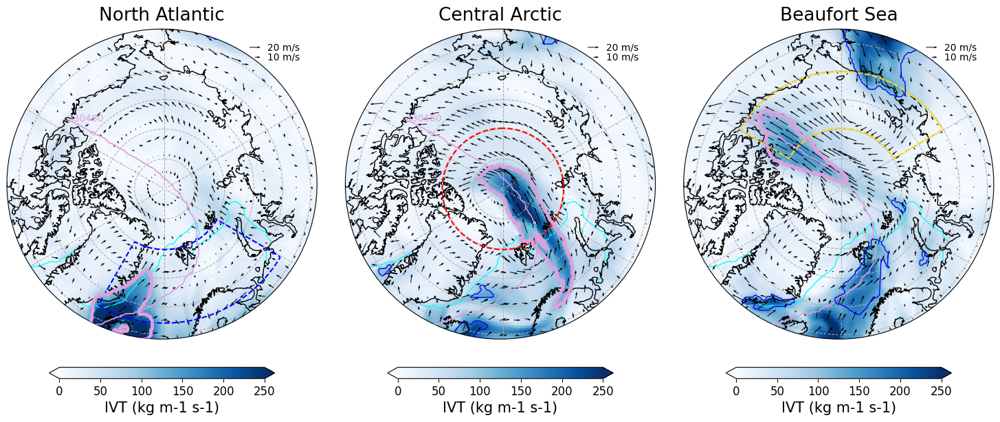

In [97]:
fig, axs = plt.subplots(1, 3, figsize=(18, 10),
                        subplot_kw={'projection': ccrs.Orthographic(0, 90)})


axs = axs.flatten()

domains = ['NorthAtlantic','CentralArctic','BeaufortSiberianSea']
domain_name = ['North Atlantic', 'Central Arctic', 'Beaufort Sea']
tt = [NA_time[0],CA_time[0],BS_time[0]]
for i,domain in enumerate(domains):
    ax = axs[i]
    ax.clear()
    ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
    ax.gridlines(linestyle='--', zorder=3)
    ax.coastlines(zorder=2)
    ax.add_feature(cartopy.feature.LAND, color='lightgray', alpha=1, zorder=0, edgecolor='black')
    #ax.add_feature(cartopy.feature.OCEAN, color='white', zorder=0, edgecolor='black')
    #fig.suptitle(f'Transarctic WAI (IVT Object) on {pd.to_datetime(tt[i].values)} and large-scale features in ERA5',fontweight='bold',y=0.97) #,ha='right' 

    
    # Clip to circle
    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)),
                                   np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)


    # Add MOAAP shape and track
    ds_moaap_sel = ds_moaap.sel(time=tt[i], method='nearest').compute()
    ds_IVT = ds_moaap_sel.IVT.plot(x='rlon', y='rlat', ax=ax, vmin=0, vmax=250,
                          cmap='Blues', transform=crs_rot,add_colorbar=False)

    obj_ids_tt = np.unique(ds_moaap_sel.IVT_Objects)
    obj_ids_tt = obj_ids_tt[obj_ids_tt != 0].astype(int)

    for obj_id in obj_ids_tt:
        if (df_objs['id'] == str(obj_id)).any():
            obj_color = 'plum'#df_objs[df_objs['id'] == str(obj_id)].color.item()
        else:
            obj_color = 'b'

        lw = 3.5 if str(obj_id) in objs_plot_ids else 1

        if str(obj_id) in objs_plot_ids:
            obj_idx = df_objs[df_objs['id'] == str(obj_id)].index.item()
            track = objs_final[obj_idx].track
            track_lats = np.array([x.lat for x in track.values])
            track_lons = np.array([x.lon for x in track.values])
            track_tt = track.sel(times=tt[i], method='nearest')
            ax.scatter(track_tt.item().lon, track_tt.item().lat, transform=crs_rot,
                       facecolor=[obj_color], edgecolor='k', s=20)
            ax.plot(track_lons, track_lats, color=obj_color, lw=1.25, transform=crs_rot, zorder=8)
            ax.text(track_lons[-1], track_lats[-1], obj_id, transform=crs_rot, color=obj_color, zorder=11)

        (ds_moaap_sel.IVT_Objects == obj_id).plot.contour(x='rlon', y='rlat', ax=ax, levels=1,
                                                          colors=[obj_color], linewidths=lw,
                                                          transform=crs_rot, zorder=10)

    # Add wind (quiver)
    time_sel = tt[i]
    u = ds_wind_u.ua.sel(time=time_sel)
    v = ds_wind_v.va.sel(time=time_sel)
    
    lat = u.lat.values
    lon = u.lon.values
    lon2d, lat2d = np.meshgrid(lon, lat)
    u_vals = u.values
    v_vals = v.values

    x, y, u_rot, v_rot = rotate_vectors(lat2d, lon2d, u_vals, v_vals, source_crs=ccrs.PlateCarree(), target_crs=ccrs.Orthographic(0, 90))

    step_lat = 10
    step_lon = 17
    
    x_sub = x[::step_lat, ::step_lon]
    y_sub = y[::step_lat, ::step_lon]
    u_rot_sub = u_rot[::step_lat, ::step_lon]
    v_rot_sub = v_rot[::step_lat, ::step_lon]
    lat_sub = lat2d[::step_lat, ::step_lon]

    
    # thinning at higher latitudes so that it does not look too crowded
    mask = np.ones(u_rot_sub.shape, dtype=bool)
    
    for j, lat_val in enumerate(lat_sub[:, 0]):
        abs_lat = abs(lat_val)
        if abs_lat > 88:
            mask[j, :] = False  # Remove all arrows >88°
        elif abs_lat > 85:
            # Keep only every 3rd arrow
            mask[j, :] = False
            mask[j, ::3] = True
        elif abs_lat > 80:
            # Keep every 2nd arrow
            mask[j, ::2] = True
            mask[j, 1::2] = False
    
    x_plot = x_sub[mask]
    y_plot = y_sub[mask]
    u_plot = u_rot_sub[mask]
    v_plot = v_rot_sub[mask]

    quiv = ax.quiver(x_plot, y_plot, u_plot, v_plot,transform=ccrs.Orthographic(0,90), color='k', scale=500, zorder=3)

    #Add quiverkey
    ax.quiverkey(quiv, X=0.85, Y=0.95, U=10,label='10 m/s', labelpos='E')
    ax.quiverkey(quiv, X=0.85, Y=0.985, U=20,label='20 m/s', labelpos='E')
    
    
    cbar = plt.colorbar(ds_IVT, ax=ax, orientation='horizontal', pad=0.08, shrink=0.8, extend='both')
    cbar.set_label('IVT (kg m-1 s-1)', fontsize=15)
    cbar.ax.tick_params(labelsize=12)


    
    #Add sea ice
    ds_sic_DJF.sic.plot.contour(levels=1, ax = ax, transform = ccrs.PlateCarree(), colors = 'cyan', linewidths = 1, linestyles = '-',zorder=1)


    # Optional domain outlines
    mask_domains[domain]["mask"].plot.contour(levels=1, colors=mask_domains[domain]["color"],
                                          linewidths=1.5, linestyles='--',
                                          zorder=4, ax=ax, transform=ccrs.PlateCarree())

    ax.set_title(f"{domain_name[i]}", y=1.06)
  


#plt.tight_layout()
plt.savefig('/work/aa0049/a271122/scripts/'+f"casestudy_2012_IVT_wind.jpg",dpi=300,bbox_inches="tight")#,transparent=True)

    
plt.show()


In [104]:

domains = ['NorthAtlantic','CentralArctic','BeaufortSiberianSea']
tt = [objs_plot_times[90],objs_plot_times[95],objs_plot_times[100]]
for i,domain in enumerate(domains):
    print(type(tt[i].values))
    print('domain:' +domain)

<class 'numpy.datetime64'>
domain:NorthAtlantic
<class 'numpy.datetime64'>
domain:CentralArctic
<class 'numpy.datetime64'>
domain:BeaufortSiberianSea


## Object tracks

In [ ]:
## Example: plot one object (

objs_plot_ids = ['330480']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

for tt in objs_plot_times[::6]:

    moaap_object_plot(tt,ds_moaap,save_figs=False,show_figs=True)

In [75]:
plt.rcParams.update(plt.rcParamsDefault)

In [76]:
plt.rcParams.update({
    "axes.labelsize": 16,
    "xtick.labelsize": 14,
    "ytick.labelsize": 14,
    "legend.fontsize": 14,
    "axes.titlesize": 16
})


In [78]:
# could be modified to a simpler version at the beginning, later use this as base 

# Define the plotting function
def moaap_plot_whole_object(obj_plot_times,title,ax=None,save_figs=False,show_figs=True):

    step_hours = 6
    time0 = pd.to_datetime(obj_plot_times[0].values)
    time_deltas = [(pd.to_datetime(tt.values) - time0).total_seconds() / 3600 for tt in obj_plot_times]
    
    # compute how many bins are needed
    max_hours = max(time_deltas)
    n_bins = int(np.ceil(max_hours / step_hours)) 
    
    # make a ListedColormap with n_bins discrete colors
    cmap = plt.get_cmap("cmo.balance", n_bins)  # force tab20b into discrete bins
    bounds = np.arange(0, (n_bins+1) * step_hours, step_hours)
    norm = mcolors.BoundaryNorm(boundaries=bounds, ncolors=cmap.N)
    
    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    
    fig, ax = plt.subplots(1, 1, subplot_kw={'projection': ccrs.Orthographic(0, 90)},figsize=(9,9))
    for i, (tt, delta_hours) in enumerate(zip(obj_plot_times[::6], time_deltas[::6])):
        discrete_delta = (delta_hours // step_hours) * step_hours
        color = cmap(norm(discrete_delta))  # use discrete delta for color
        z = 100 - i  # ensure older shapes are on top

        ds_moaap_sel = ds_moaap.sel(time=tt, method='nearest')
        obj_ids_tt = np.unique(ds_moaap_sel.IVT_Objects)
        obj_ids_tt = obj_ids_tt[obj_ids_tt != 0].astype(int)
    
        for obj_id in obj_ids_tt:
            if str(obj_id) in objs_plot_ids:
                obj_mask = (ds_moaap_sel.IVT_Objects == obj_id)
                
                # Use contour to extract boundary path
                contours = obj_mask.plot.contour(x='rlon', y='rlat', ax=ax, levels=[0.5], colors='none',linewidths=0.0, transform=crs_rot, zorder=z+0.5, add_colorbar=False) #colors='none', lw=0
    
                for segs in contours.allsegs:
                    for seg in segs:
                        path = mpath.Path(seg)
                        patch = mpatches.PathPatch(path,facecolor=color,edgecolor='none',transform=crs_rot,zorder=z,alpha=0.9)
                        ax.add_patch(patch)
    #add sea ice
    #(ds_sic_DJF.sic>85).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='k',linewidths=1)
    #(ds_sic_DJF.sic>15).plot.contour(levels=1,ax=ax,transform=ccrs.PlateCarree(),colors='gray',linestyle='--',linewidths=1)

    if mask_domains:
        for domain_name, domain_data in mask_domains.items():
            domain_data["mask"].plot.contour(levels=1, colors=domain_data["color"],linewidths=1.5, linestyles='--', zorder=4, ax=ax, transform=ccrs.PlateCarree())

    
    #ax settings

    ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
    #ax.gridlines(linestyle='--',zorder=3)
    ax.coastlines(zorder=2)
    #ax.add_feature(cartopy.feature.LAND, color='lightgray',alpha=0.8,zorder=0, edgecolor='black') 
    #ax.add_feature(cartopy.feature.OCEAN, color='white',zorder=0, edgecolor='None')
    
    ax.set_aspect('equal')
    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)), np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    ax.set_title("")#f"ID: {str(objs_plot_ids)} Start: {time0.strftime('%Y-%m-%d %H:%M')}", y=1.05)
    ax.set_position([0.25, 0.1, 0.5, 0.8])  # [left, bottom, width, height]

        # Add colorbar
    cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', shrink=0.75, pad=0.08, extend='both')
    cbar.set_label("Hours since start (h)")#,fontsize=16)
    #cbar.ax.tick_params(labelsize=16) 
    cbar.set_ticks([0,24,48,72,96,120,144])

    if save_figs==True: 
        path_movies='/work/aa0049/a271122/scripts/ERA5/'
        plt.tight_layout()
        plt.savefig(path_movies + "casestudy_whole_object.jpg",dpi=300,transparent=True)
        #plt.close(fig)
        
    if show_figs==True:
        #plt.tight_layout()
        plt.show()
        
    else:
        plt.clf()
        plt.close(fig)

In [39]:
from matplotlib.path import Path as MplPath
from matplotlib.patches import PathPatch

def moaap_plot_whole_object_combined(obj_plot_times, ax=None, show_figs=True):
    if ax is None:
        fig, ax = plt.subplots(1, 1, subplot_kw={'projection': ccrs.Orthographic(0, 90)})

    all_paths = []

    for tt in obj_plot_times:
        ds_moaap_sel = ds_moaap.sel(time=tt, method='nearest')
        obj_ids_tt = np.unique(ds_moaap_sel.IVT_Objects)
        obj_ids_tt = obj_ids_tt[obj_ids_tt != 0].astype(int)

        for obj_id in obj_ids_tt:
            if str(obj_id) in objs_plot_ids:
                obj_mask = (ds_moaap_sel.IVT_Objects == obj_id)
                
                # Get contours
                masks = obj_mask.plot(
                    x='rlon', y='rlat', ax=ax, colors='none',
                    transform=crs_rot, zorder=1, add_colorbar=False
                )

                for collection in masks.collections:
                    for path in collection.get_paths():
                        all_paths.append(path)

    # Merge all paths into one
    merged_vertices = []
    merged_codes = []

    for path in all_paths:
        merged_vertices.extend(path.vertices)
        merged_codes.extend(path.codes)

    merged_path = MplPath(merged_vertices, merged_codes)
    patch = PathPatch(merged_path, facecolor='gray', transform=crs_rot, zorder=2, alpha=0.7)
    ax.add_patch(patch)

    # Basic map setup
    ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.gridlines(linestyle='--')
    ax.set_aspect('equal')

    # Circular boundary for polar projection
    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)),
                                   np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    if show_figs:
        plt.show()
    else:
        plt.close()


In [36]:
def calculate_total_area(obj_plot_times): 
    
    # Select a reference shape for mask
    ny, nx = ds_moaap['IVT_Objects'].isel(time=0).shape
    total_mask = np.zeros((ny, nx), dtype=bool)
    
    
    for tt in obj_plot_times:
        ds_moaap_sel = ds_moaap.sel(time=tt, method='nearest')
        mask_data = ds_moaap_sel.IVT_Objects.values
        
        # Find all objects to keep in this timestep
        valid_ids = [int(oid) for oid in np.unique(mask_data) if oid != 0 and str(int(oid)) in objs_plot_ids]
        if valid_ids:
            # Create a mask for any valid object in this timestep (fast)
            obj_mask = np.isin(mask_data, valid_ids)
            total_mask |= obj_mask
    
    # Load rlon/rlat
    rlon = ds_moaap['rlon'].values
    rlat = ds_moaap['rlat'].values
    rlon2d, rlat2d = np.meshgrid(rlon, rlat)
    
    
    # Transform to PlateCarree (true lat/lon)
    crs_plate = ccrs.PlateCarree()
    lonlat = crs_rot.transform_points(crs_plate, rlon2d, rlat2d)
    lon2d = lonlat[..., 0]
    lat2d = lonlat[..., 1]
    
    
    geod = Geod(ellps="WGS84")
    area_km2 = np.zeros((lat2d.shape[0]-1, lat2d.shape[1]-1))
    
    for i in range(area_km2.shape[0]):
        for j in range(area_km2.shape[1]):
            lon_corners = [lon2d[i,j], lon2d[i,j+1], lon2d[i+1,j+1], lon2d[i+1,j]]
            lat_corners = [lat2d[i,j], lat2d[i,j+1], lat2d[i+1,j+1], lat2d[i+1,j]]
            poly_area, _ = geod.polygon_area_perimeter(lon_corners, lat_corners)
            area_km2[i,j] = abs(poly_area) / 1e6  # m² → km²
    
    
    # Mask must match area grid shape (one cell smaller in each direction)
    masked = total_mask[:-1, :-1]  # crop to match area_km2 shape
    total_area_km2 = np.sum(area_km2[masked])
    
    
    return total_area_km2
        

In [64]:
objs_plot_ids = ['330480']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

total_area_km2 = calculate_total_area(objs_plot_times)
print(str(objs_plot_ids)+": "+str(total_area_km2)+' km2')

['330480']: 8354902.401228085 km2


In [66]:
total_area_list = []
time_list = []
id_list = []
for i in range(1,13): 
    
    objs_plot_ids = [objs_final[i]['id_'].item()]
    objs_plot_times = xr.concat(
        [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
        dim='times').sortby('times').drop_duplicates(dim='times')
    total_area_km2 = calculate_total_area(objs_plot_times)


    total_area_list.append(total_area_km2)
    print(str(objs_plot_ids)+": "+str(total_area_km2)+' km2')
    
    time_list.append(np.datetime_as_string(objs_final[i].times[0].values))
    id_list.append(objs_plot_ids)

['56275']: 11875029.172004815 km2
['110498']: 5005695.347213438 km2
['120433']: 7476165.156002308 km2
['220464']: 1902698.2991497987 km2
['236303']: 11015330.972811274 km2
['260541']: 4519859.646704951 km2
['306324']: 5644808.920551557 km2
['320482']: 5785376.400970361 km2
['330480']: 8354902.401228085 km2
['350573']: 5545284.429782888 km2
['376396']: 10784841.205819463 km2
['390547']: 5934036.582818327 km2


In [23]:
##Calculate total track length for a given track
def calculate_track_length_geopy(track_lats, track_lons):
    total_distance = 0.0
    for i in range(len(track_lats) - 1):
        point1 = (track_lats[i], track_lons[i]) 
        point2 = (track_lats[i + 1], track_lons[i + 1])
        total_distance += distance(point1, point2).km
    return total_distance


In [29]:
duration = []
track_length = []
# For each WAIs in objs_final:
for i in range(1,13): 
    
    #Calculate duration 
    duration.append(len(objs_final[i].times))

    #Calculate length 
    track=objs_final[i].track.values
        
    track_lats = np.array([x.lat for x in track])
    track_lons = np.array([x.lon for x in track]) 

    tot_distance = calculate_track_length_geopy(track_lats,track_lons)
    track_length.append(round(tot_distance,2))


In [87]:
ERA5_MOAAP_values = {"date": time_list, 
                    "id_": id_list,
                    "area": total_area_list,
                    'Duration (h)': duration,
                    'Length (km)': track_length}
}


df_ERA5_MOAAP = pd.DataFrame(ERA5_MOAAP_values)

In [36]:
df_ERA5_MOAAP.to_csv('/work/aa0049/a271122/ERA5/df_ERA5_MOAAP.csv')

In [37]:
df_ERA5_MOAAP = pd.read_csv('/work/aa0049/a271122/ERA5/df_ERA5_MOAAP.csv')

In [38]:
df_ERA5_MOAAP

,Unnamed: 0,date,id_,area,Duration (h),Length (km)
0,0,1984-12-12T00:00:00.000000000,['56275'],1.187503e+07,188,12081.49
1,1,1990-01-20T21:00:00.000000000,['110498'],5.005695e+06,91,5494.19
2,2,1991-01-25T23:00:00.000000000,['120433'],7.476165e+06,113,8703.55
3,3,2001-01-02T10:00:00.000000000,['220464'],1.902698e+06,137,5034.00
4,4,2002-12-04T14:00:00.000000000,['236303'],1.101533e+07,135,7102.60
5,5,2005-01-25T11:00:00.000000000,['260541'],4.519860e+06,77,3977.46
6,6,2009-12-09T17:00:00.000000000,['306324'],5.644809e+06,146,9243.72
7,7,2011-01-19T16:00:00.000000000,['320482'],5.785376e+06,100,8592.70
8,8,2012-01-12T03:00:00.000000000,['330480'],8.354902e+06,141,7614.34
9,9,2014-02-07T18:00:00.000000000,['350573'],5.545284e+06,157,7385.17


In [39]:
df_ERA5_MOAAP = df_ERA5_MOAAP.drop('Unnamed: 0',axis='columns')

In [40]:
df_ERA5_MOAAP

,date,id_,area,Duration (h),Length (km)
0,1984-12-12T00:00:00.000000000,['56275'],1.187503e+07,188,12081.49
1,1990-01-20T21:00:00.000000000,['110498'],5.005695e+06,91,5494.19
2,1991-01-25T23:00:00.000000000,['120433'],7.476165e+06,113,8703.55
3,2001-01-02T10:00:00.000000000,['220464'],1.902698e+06,137,5034.00
4,2002-12-04T14:00:00.000000000,['236303'],1.101533e+07,135,7102.60
5,2005-01-25T11:00:00.000000000,['260541'],4.519860e+06,77,3977.46
6,2009-12-09T17:00:00.000000000,['306324'],5.644809e+06,146,9243.72
7,2011-01-19T16:00:00.000000000,['320482'],5.785376e+06,100,8592.70
8,2012-01-12T03:00:00.000000000,['330480'],8.354902e+06,141,7614.34
9,2014-02-07T18:00:00.000000000,['350573'],5.545284e+06,157,7385.17


In [52]:
objs_plot_ids = ['110498']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')



Total area: 5005695.35 km²


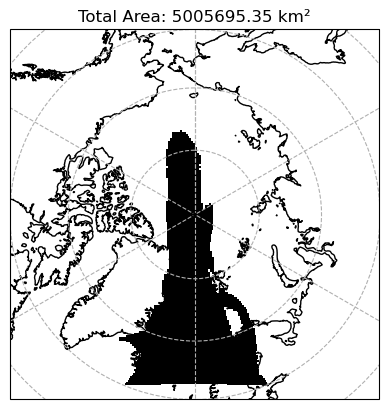

In [53]:
import pyproj
from pyproj import Geod
import cartopy.crs as ccrs
import numpy as np

# Select a reference shape for mask
ny, nx = ds_moaap['IVT_Objects'].isel(time=0).shape
total_mask = np.zeros((ny, nx), dtype=bool)


obj_plot_times = objs_plot_times

for tt in obj_plot_times:
    ds_moaap_sel = ds_moaap.sel(time=tt, method='nearest')
    mask_data = ds_moaap_sel.IVT_Objects.values
    
    # Find all objects to keep in this timestep
    valid_ids = [int(oid) for oid in np.unique(mask_data) if oid != 0 and str(int(oid)) in objs_plot_ids]
    if valid_ids:
        # Create a mask for any valid object in this timestep (fast)
        obj_mask = np.isin(mask_data, valid_ids)
        total_mask |= obj_mask

# Load rlon/rlat
rlon = ds_moaap['rlon'].values
rlat = ds_moaap['rlat'].values
rlon2d, rlat2d = np.meshgrid(rlon, rlat)

# Define rotated pole CRS (already defined somewhere in your session)
# crs_rot = ccrs.RotatedPole(...)

# Transform to PlateCarree (true lat/lon)
crs_plate = ccrs.PlateCarree()
lonlat = crs_rot.transform_points(crs_plate, rlon2d, rlat2d)
lon2d = lonlat[..., 0]
lat2d = lonlat[..., 1]


geod = Geod(ellps="WGS84")
area_km2 = np.zeros((lat2d.shape[0]-1, lat2d.shape[1]-1))

for i in range(area_km2.shape[0]):
    for j in range(area_km2.shape[1]):
        lon_corners = [lon2d[i,j], lon2d[i,j+1], lon2d[i+1,j+1], lon2d[i+1,j]]
        lat_corners = [lat2d[i,j], lat2d[i,j+1], lat2d[i+1,j+1], lat2d[i+1,j]]
        poly_area, _ = geod.polygon_area_perimeter(lon_corners, lat_corners)
        area_km2[i,j] = abs(poly_area) / 1e6  # m² → km²


# Mask must match area grid shape (one cell smaller in each direction)
masked = total_mask[:-1, :-1]  # crop to match area_km2 shape
total_area_km2 = np.sum(area_km2[masked])

print(f"Total area: {total_area_km2:.2f} km²")

fig, ax = plt.subplots(1, 1, subplot_kw={'projection': ccrs.Orthographic(0, 90)})

pcm = ax.pcolormesh(
    ds_moaap['rlon'], ds_moaap['rlat'],
    total_mask,
    transform=crs_rot,
    cmap='Greys',
    shading='auto'
)

ax.set_extent([-180, 180, 60, 90], crs=ccrs.PlateCarree())
ax.coastlines()
ax.gridlines(linestyle='--')
plt.title(f"Total Area: {total_area_km2:.2f} km²")
plt.show()



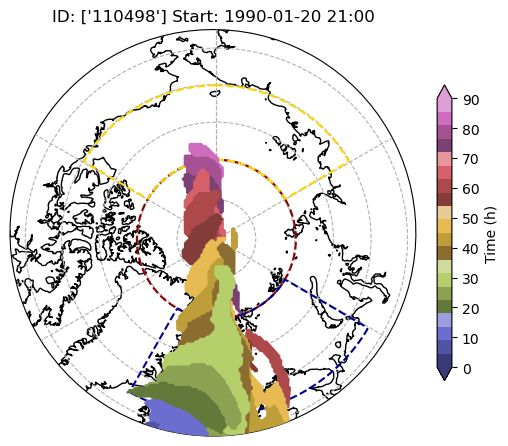

In [148]:
## Example: plot one object (

objs_plot_ids = ['110498']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

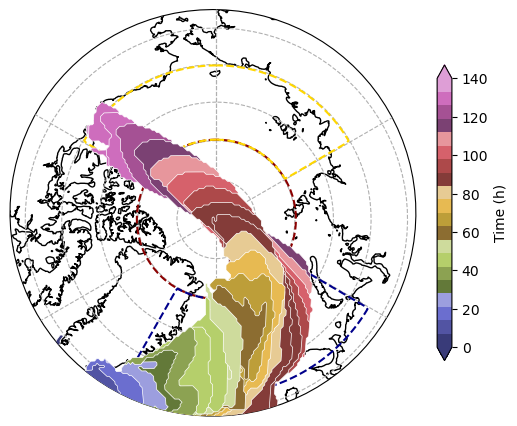

In [128]:
## Example: plot one object (

objs_plot_ids = ['330480']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

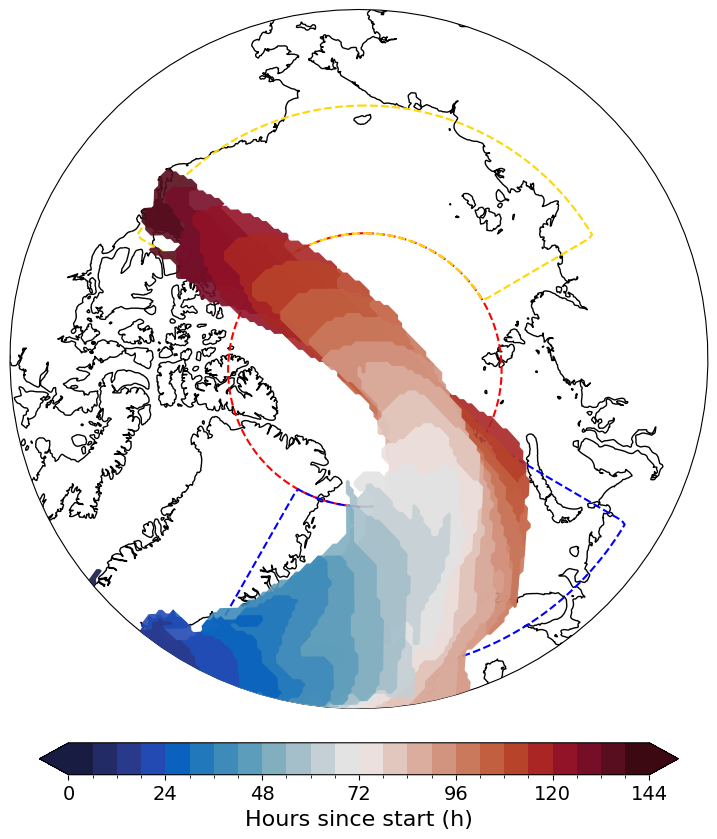

In [79]:
## Example: plot one object (

objs_plot_ids = ['330480']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs_final if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=True,show_figs=True)

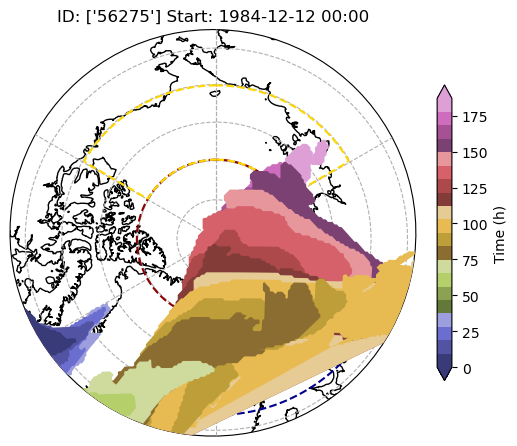

In [147]:
## Example: plot one object (

objs_plot_ids = ['56275']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

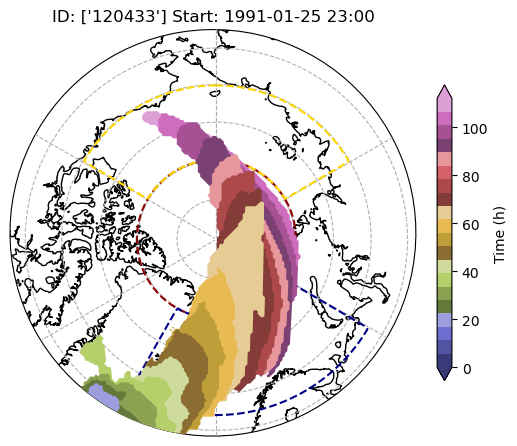

In [149]:
## Example: plot one object (

objs_plot_ids = ['120433']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

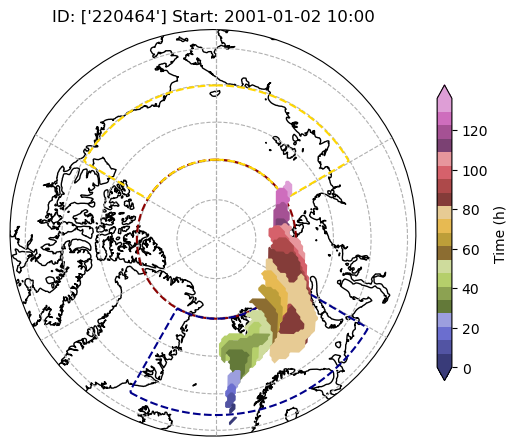

In [150]:
## Example: plot one object (

objs_plot_ids = ['220464']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

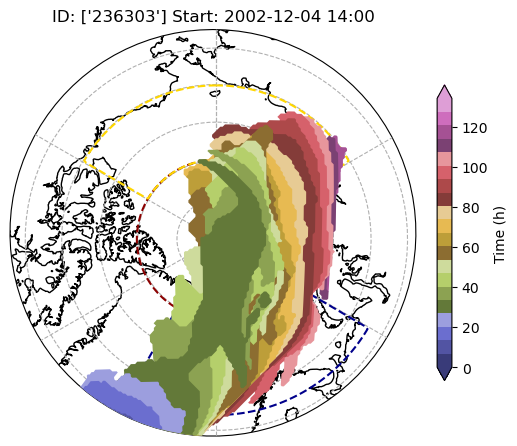

In [151]:
## Example: plot one object (

objs_plot_ids = ['236303']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

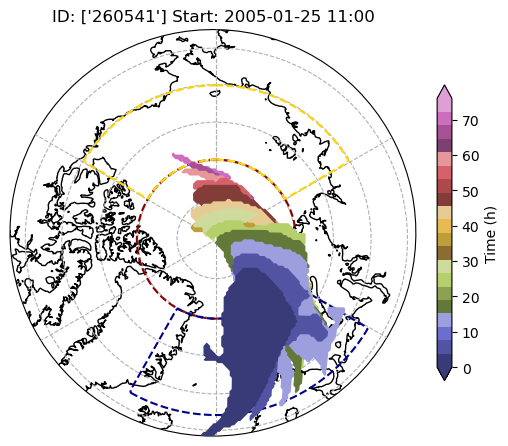

In [139]:
## Example: plot one object (

objs_plot_ids = ['260541']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

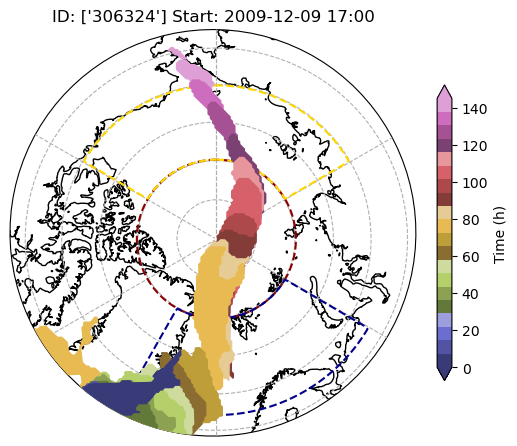

In [140]:
## Example: plot one object (

objs_plot_ids = ['306324']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

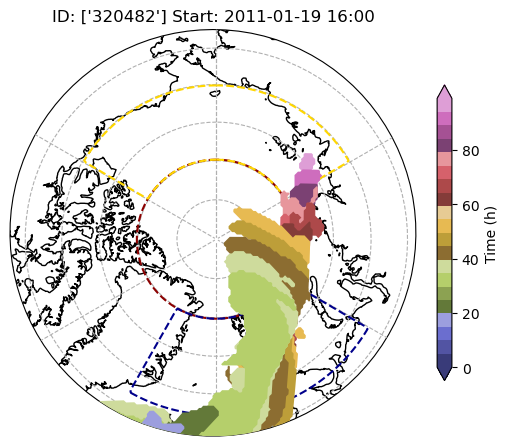

In [141]:
## Example: plot one object (

objs_plot_ids = ['320482']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

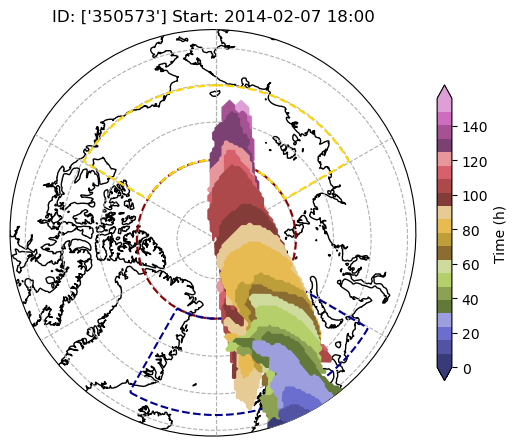

In [142]:
## Example: plot one object (

objs_plot_ids = ['350573']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

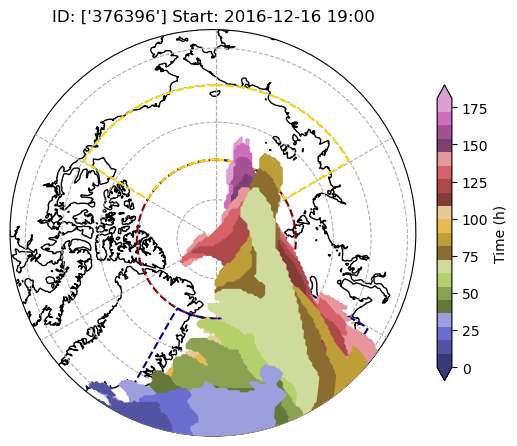

In [143]:
## Example: plot one object (

objs_plot_ids = ['376396']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

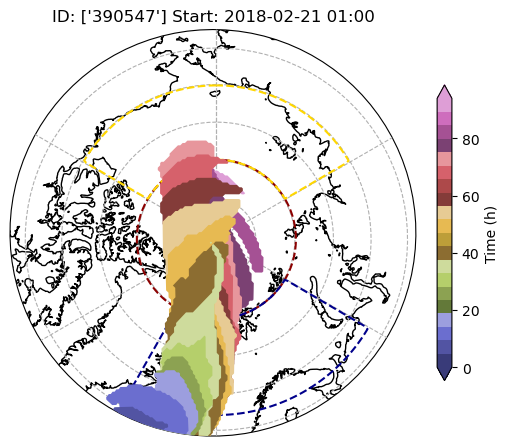

In [145]:
## Example: plot one object (

objs_plot_ids = ['390547']#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
# MOSAiC 2020-04 cases: ['1220826','1220835']

objs_plot_times = xr.concat(
    [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
    dim='times').sortby('times').drop_duplicates(dim='times')

moaap_plot_whole_object(objs_plot_times,title='',ax=None,save_figs=False,show_figs=True)

In [ ]:
ds_moaap_cyclones = xr.open_mfdataset('/work/aa0049/a271122/ERA5/ERA5_MOAAP_cyclones/*_ERA5_ObjectMasks__dt-1h_MOAAP-masks.nc')

In [97]:
def plot_WAIS_cyclones_zg(tt,dataset, var, ds_moaap,ds_moaap_cyclones, df_objs, objs, objs_plot_ids, crs_rot, mask_domains=None,savefig=False,show_figs=True):
    fig, ax = plt.subplots(1,1, figsize=(7, 7),
                            subplot_kw={'projection': ccrs.Orthographic(0, 90)})
    

    ax.set_extent([-180, 180, 65, 90], crs=ccrs.PlateCarree())
    ax.gridlines(linestyle='--', zorder=3)
    ax.coastlines(zorder=2)
    ax.add_feature(cartopy.feature.LAND, color='lightgray', alpha=1, zorder=0, edgecolor='black')

    #ax.add_feature(cartopy.feature.OCEAN, color='white', zorder=0, edgecolor='black')
    #fig.suptitle(f'Transarctic WAIs (IVT Objects) and large-scale features for ERA5 DJF | {pd.to_datetime(tt.values)}',fontweight='bold',y=0.97) #,ha='right' 
    
    # Clip to circle
    center, radius = [0.5, 0.5], 0.55
    circle = mpath.Path(np.vstack([np.sin(np.linspace(0, 2*np.pi, 100)),
                                   np.cos(np.linspace(0, 2*np.pi, 100))]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    #Plot zg anomaly
    ds_zg = dataset
    ds_clim = xr.open_dataset(f'{ERA5_clim_path}/zg/clim/zg_clim_day_DJF.nc',chunks={'time': 10})

    #Compute anomaly
    tt_dt = pd.to_datetime(tt.values)
    month_day_str = f"{tt_dt.month:02d}-{tt_dt.day:02d}"
    
    
    var_tot = ds_zg[var].sel(time=tt, method='nearest')

    var_clim = ds_clim[var].sel(time=ds_clim.time.dt.strftime('%m-%d') == month_day_str)
    
    var_anom = var_tot - var_clim
    var_anom = var_anom.assign_coords(lon=((var_anom.lon + 180) % 360) - 180).sortby(['lat','lon'])
    
    var_anom_plot = var_anom.plot(ax=ax, cmap='RdBu_r', transform=ccrs.PlateCarree(),vmin=-120,vmax=120,add_colorbar=False)

    add_custom_colorbar(var_anom_plot, ax, ds_zg, 'zg')

    # Plot tracked objects
    ds_moaap_sel = ds_moaap.sel(time=tt, method='nearest').compute()
    obj_ids_tt = np.unique(ds_moaap_sel.IVT_Objects)
    obj_ids_tt = obj_ids_tt[obj_ids_tt != 0].astype(int)

    for obj_id in obj_ids_tt:
        if (df_objs['id'] == str(obj_id)).any():
            obj_color = df_objs[df_objs['id'] == str(obj_id)].color.item()
        else:
            obj_color = 'b'

        lw = 3 if str(obj_id) in objs_plot_ids else 1

        if str(obj_id) in objs_plot_ids:
            obj_idx = df_objs[df_objs['id'] == str(obj_id)].index.item()
            track = objs[obj_idx].track
            track_lats = np.array([x.lat for x in track.values])
            track_lons = np.array([x.lon for x in track.values])
            track_tt = track.sel(times=tt, method='nearest')
            ax.scatter(track_tt.item().lon, track_tt.item().lat, transform=crs_rot,
                       facecolor='#FB9A99', edgecolor='k', s=20)
            ax.plot(track_lons, track_lats, color='#FB9A99', lw=0.75, transform=crs_rot, zorder=8)
            ax.text(track_lons[-1], track_lats[-1], obj_id, transform=crs_rot, color='#FB9A99', zorder=11)

        (ds_moaap_sel.IVT_Objects == obj_id).plot.contour(x='rlon', y='rlat', ax=ax, levels=1,
                                                          colors='#FB9A99', linewidths=lw,
                                                          transform=crs_rot, zorder=10)

    #Add sea ice
    ds_sic_DJF.sic.plot.contour(levels=1, ax = ax, transform = ccrs.PlateCarree(), colors = 'cyan', linewidths = 1, linestyles = '-',zorder=1)

    #Add cyclones
    moaap_cyclones_sel = ds_moaap_cyclones.sel(time=tt,method='nearest')
    
    
    colors = [(0, 0, 0, 0), (0.5, 0.5, 0.5, 0.6)]  
    cmap = mcolors.ListedColormap(colors)
    bounds = [0, 50, 150]  # bins between 0 and 100
    norm = mcolors.BoundaryNorm(bounds, cmap.N)

    mesh = ax.pcolormesh(moaap_cyclones_sel.lon, moaap_cyclones_sel.lat, moaap_cyclones_sel.CY_Objects, transform=ccrs.PlateCarree(),
                         shading='auto', cmap=cmap, norm=norm)
    

    # Optional domain outlines
    if mask_domains:
        for domain_name, domain_data in mask_domains.items():
            domain_data["mask"].plot.contour(levels=1, colors=domain_data["color"],
                                             linewidths=1.5, linestyles='--',
                                             zorder=4, ax=ax, transform=ccrs.PlateCarree())
    ax.set_title(f"Time: {pd.to_datetime(tt.values)}",y=1.05)  
    

    if savefig==True:
        path_input_images='ERA5/'
        path_movies='/work/aa0049/a271122/scripts/movies/cyclones/'
        plt.savefig(path_movies + f"{pd.to_datetime(tt.values).strftime('%Y-%m-%dT%H-%M')}.jpg",dpi=300)#,transparent=True)
        #plt.close(fig)#
        
    if show_figs==True:
        plt.show()
    else:
        plt.clf()
        plt.close(fig)



In [ ]:
for i in range(11,13): 
    
    objs_plot_ids = [objs_final[i]['id_'].item()]#['1220835'] # ids_sel # ['1220826','1220835'] #['1030505','1036731']  # list of selected object IDs
    # MOSAiC 2020-04 cases: ['1220826','1220835']
    
    objs_plot_times = xr.concat(
        [obj.times for obj in objs if obj.id_.item() in objs_plot_ids],
        dim='times').sortby('times').drop_duplicates(dim='times')
    
    for tt in objs_plot_times[::2]:    
        plot_WAIS_cyclones_zg(tt,ds_zg,'zg',ds_moaap,ds_moaap_cyclones,df_objs, objs, objs_plot_ids, crs_rot,mask_domains,savefig=True,show_figs=False)

In [3]:
ds_moaap_cyclones

<xarray.Dataset>
Dimensions:      (time: 152472, yc: 582, xc: 577)
Coordinates:
  * time         (time) datetime64[ns] 1979-11-01 ... 2021-03-31T23:00:00
    lat          (yc, xc) float32 dask.array<chunksize=(582, 577), meta=np.ndarray>
    lon          (yc, xc) float32 dask.array<chunksize=(582, 577), meta=np.ndarray>
Dimensions without coordinates: yc, xc
Data variables:
    CY_Objects   (time, yc, xc) float32 dask.array<chunksize=(3648, 582, 577), meta=np.ndarray>
    ACY_Objects  (time, yc, xc) float32 dask.array<chunksize=(3648, 582, 577), meta=np.ndarray>
    SLP          (time, yc, xc) float32 dask.array<chunksize=(3648, 582, 577), meta=np.ndarray>
Attributes:
    title:    MOAAP object tracking output
    contact:  Andreas F. Prein (prein@ucar.edu)

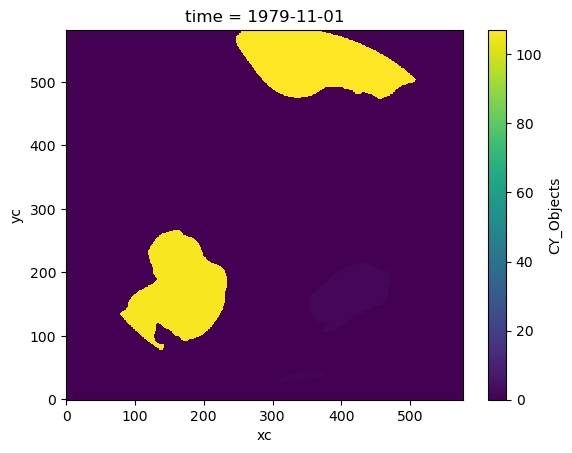

In [5]:
ds_moaap_cyclones.CY_Objects[0].plot()

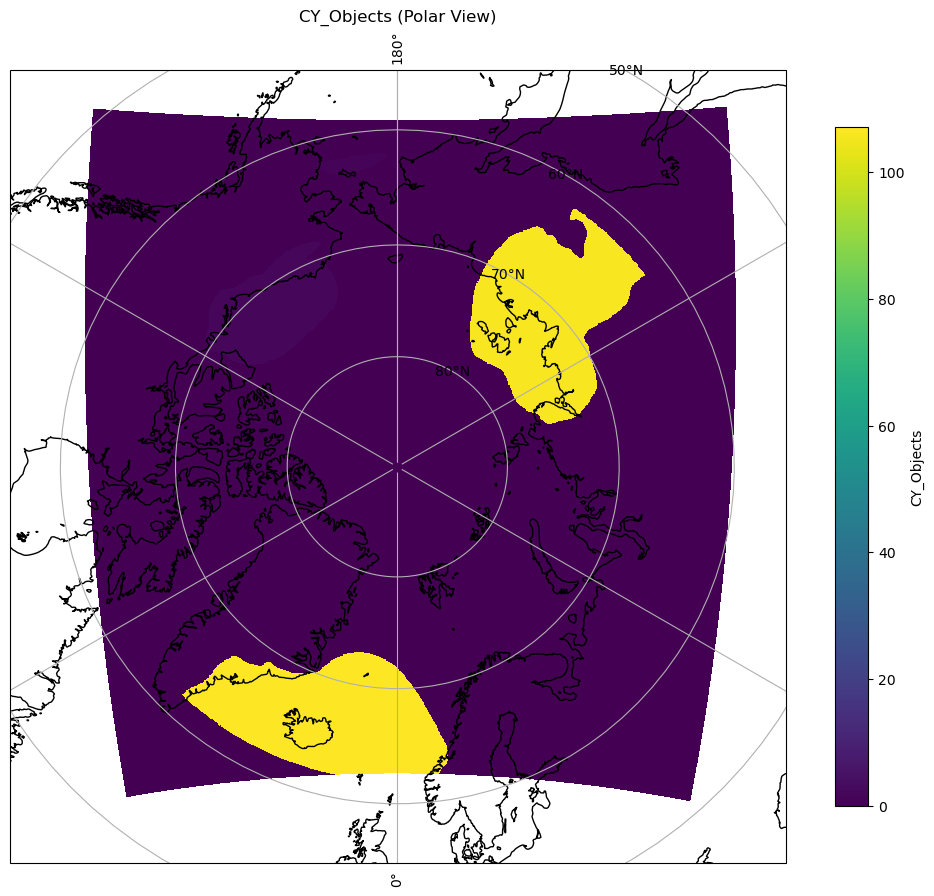

In [7]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Extract 2D lat/lon and data slice
lat = ds_moaap_cyclones['lat'].values
lon = ds_moaap_cyclones['lon'].values
data = ds_moaap_cyclones['CY_Objects'].isel(time=0).values

# Define the projection (centered on 0°E)
proj = ccrs.NorthPolarStereo(central_longitude=0)

# Create plot
fig, ax = plt.subplots(figsize=(10, 10), subplot_kw={'projection': proj})

# Plot data with geographic coordinates
mesh = ax.pcolormesh(lon, lat, data, transform=ccrs.PlateCarree(), shading='auto', cmap='viridis')

# Add map features
ax.coastlines()
ax.gridlines(draw_labels=True)
ax.set_extent([-180, 180, 55, 90], crs=ccrs.PlateCarree())  # adjust if needed
ax.set_title('CY_Objects (Polar View)')

# Add colorbar
cbar = plt.colorbar(mesh, orientation='vertical', shrink=0.7, pad=0.05)
cbar.set_label('CY_Objects')

plt.tight_layout()
plt.show()


In [197]:
### Make Animations from individual plots
#Requires all images to be in the path_input_images already
path_movies='/work/aa0049/a271122/scripts/movies/cyclones/'

# Set the path to images
image_folder = path_movies
video_name = 'movie_ERA5_cyclones_deepWAIS_DJF.mp4'

# Get sorted list of image paths
images = sorted([os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith(".jpg")])

# Create video clip
clip = ImageSequenceClip(images, fps=3)
clip.write_videofile(image_folder+video_name, codec="libx264")



MoviePy - Building video /work/aa0049/a271122/scripts/movies/cyclones/movie_ERA5_cyclones_deepWAIS_DJF.mp4.
MoviePy - Writing video /work/aa0049/a271122/scripts/movies/cyclones/movie_ERA5_cyclones_deepWAIS_DJF.mp4



MoviePy - Done !
MoviePy - video ready /work/aa0049/a271122/scripts/movies/cyclones/movie_ERA5_cyclones_deepWAIS_DJF.mp4


In [86]:
(((ds_moaap_cyclones.lon + 180) % 360) - 180)



<xarray.DataArray 'lon' (yc: 582, xc: 577)>
dask.array<sub, shape=(582, 577), dtype=float32, chunksize=(582, 577), chunktype=numpy.ndarray>
Coordinates:
    lat      (yc, xc) float32 dask.array<chunksize=(582, 577), meta=np.ndarray>
    lon      (yc, xc) float32 dask.array<chunksize=(582, 577), meta=np.ndarray>
Dimensions without coordinates: yc, xc

In [153]:
# Extract lat, lon, and data slice
lat = ds_moaap_cyclones['lat'].values
lon = ds_moaap_cyclones.lon.values
lon = lon % 360

data = ds_moaap_cyclones['CY_Objects'].isel(time=57).values


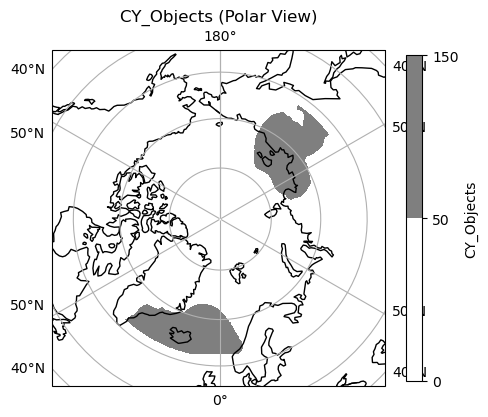

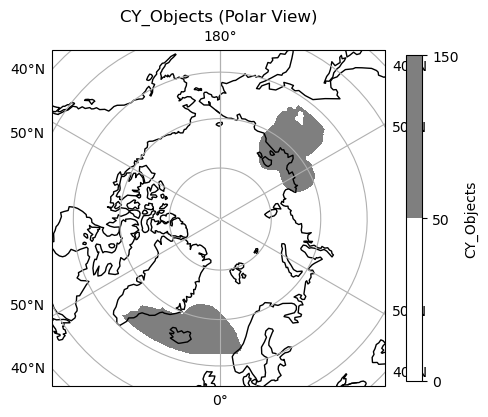

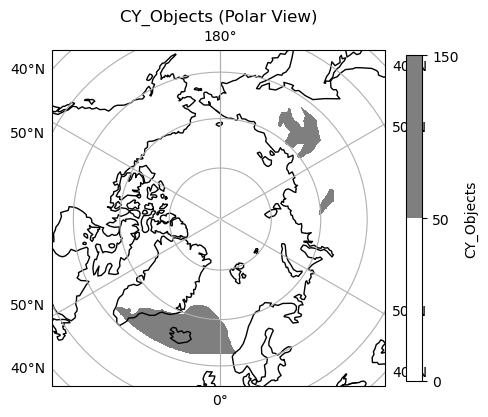

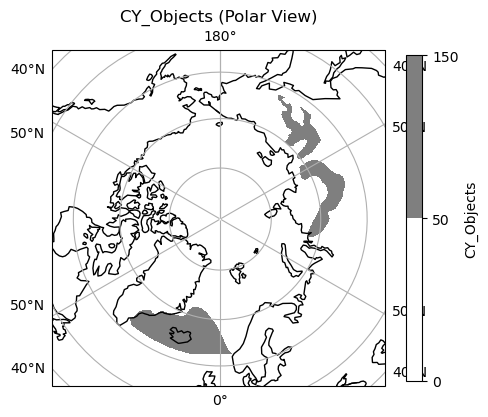

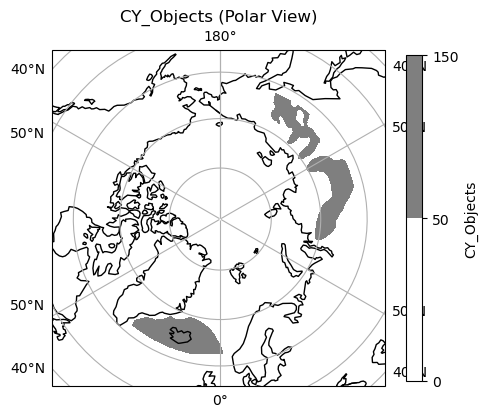

...

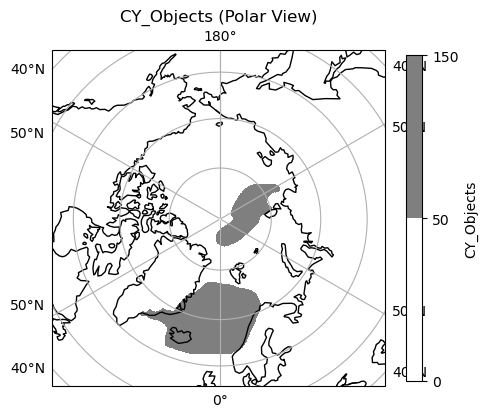

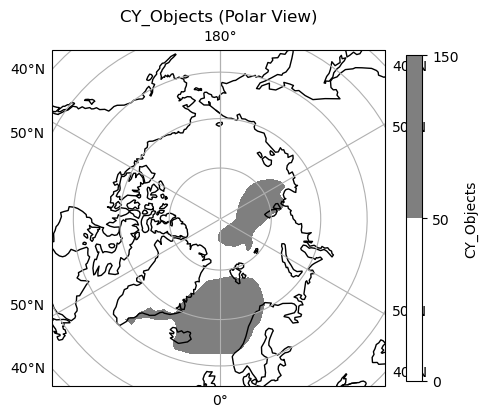

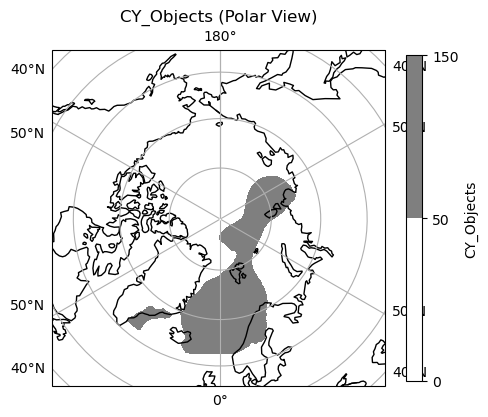

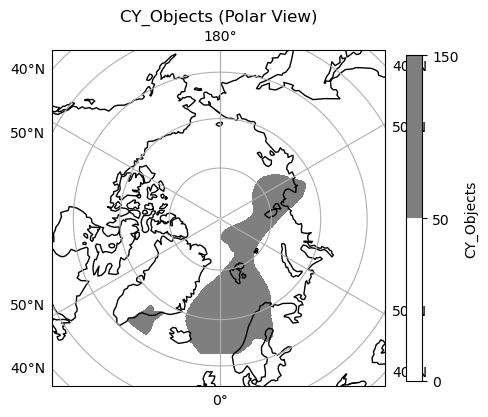

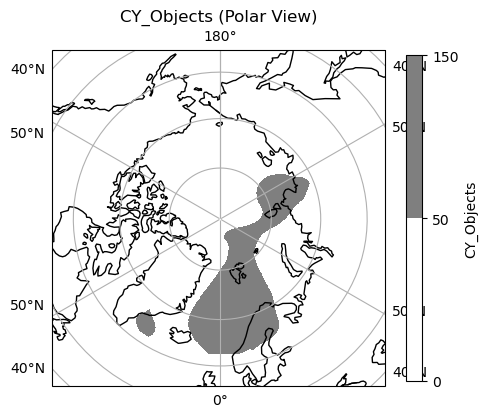

In [161]:
for i in range(0,100,5): 
    # Extract 2D lat/lon and data slice
    lat = ds_moaap_cyclones['lat'].values
    lon = ds_moaap_cyclones['lon'].values
    data = ds_moaap_cyclones['CY_Objects'].isel(time=i).values

    # Create a colormap: 0 = transparent, 100 = grey
    cmap = mcolors.ListedColormap(['none', '#7f7f7f'])
    bounds = [0, 50, 150]  # bins between 0 and 100
    norm = mcolors.BoundaryNorm(bounds, cmap.N)

    # Create Orthographic projection centered at the North Pole
    proj = ccrs.Orthographic(central_longitude=0, central_latitude=90)

    fig, ax = plt.subplots(figsize=(5, 5), subplot_kw={'projection': proj})

    mesh = ax.pcolormesh(lon, lat, data, transform=ccrs.PlateCarree(),
                         shading='auto', cmap=cmap, norm=norm)
    ax.coastlines()
    ax.gridlines(draw_labels=True)
    ax.set_extent([-180, 180, 55, 90], crs=ccrs.PlateCarree())  # adjust if needed
    ax.set_title('CY_Objects (Polar View)')
    
    # Add colorbar
    cbar = plt.colorbar(mesh, orientation='vertical', shrink=0.7, pad=0.05)
    cbar.set_label('CY_Objects')
    
    plt.tight_layout()
    plt.show()


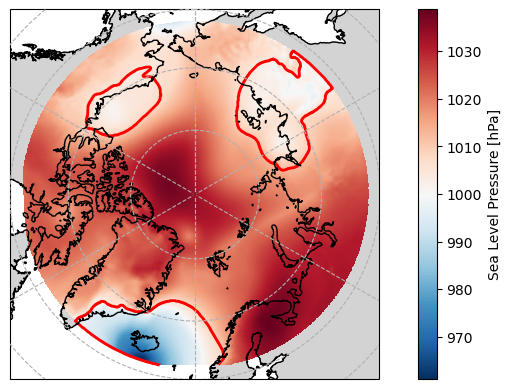

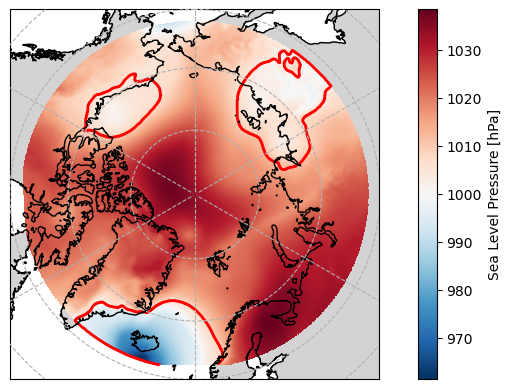

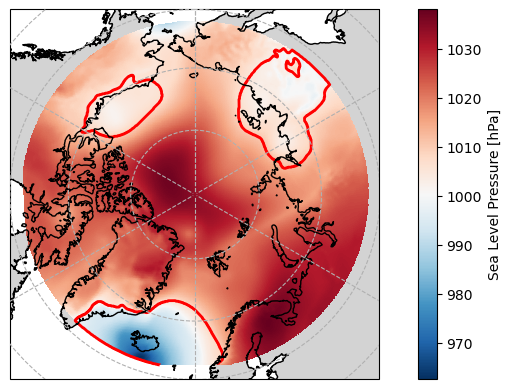

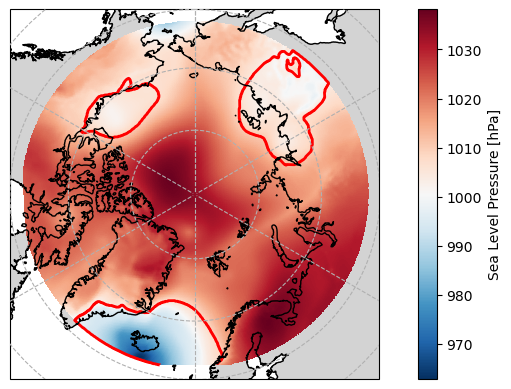

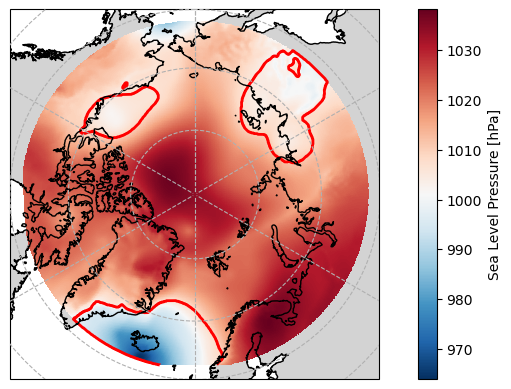

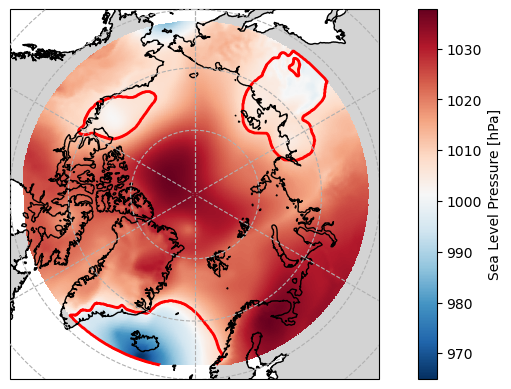

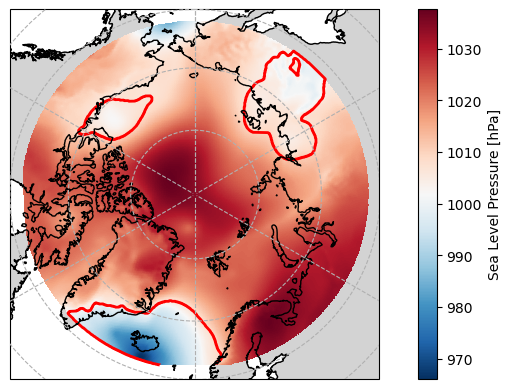

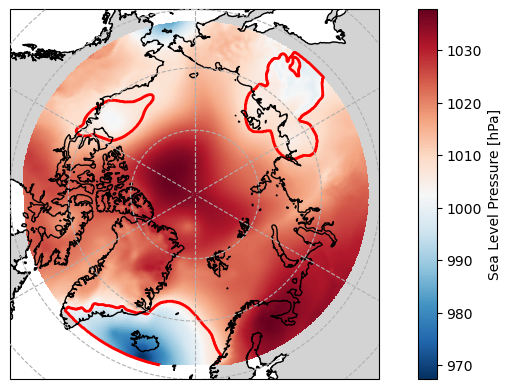

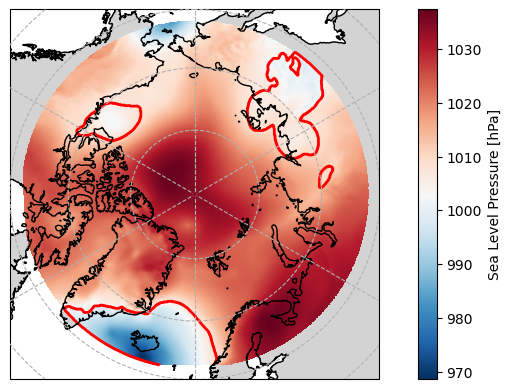

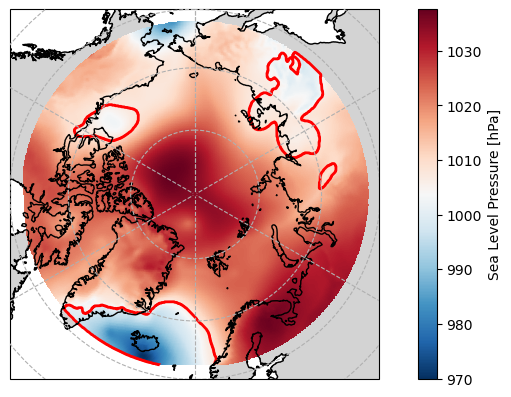

In [17]:
for i in range(0,10,1):

    fig, ax = plt.subplots(1, 1,subplot_kw={'projection': ccrs.Orthographic(0,90)})
    
    ax.contour(ds_moaap_cyclones.CY_Objects[i].lon, ds_moaap_cyclones.CY_Objects[i].lat,ds_moaap_cyclones.CY_Objects[i],transform=ccrs.PlateCarree(), colors ='r', linewidths=2,levels=[1])
    
    cbar = ax.pcolormesh((ds_moaap_cyclones.SLP[i]/100).lon, (ds_moaap_cyclones.SLP[i]/100).lat,(ds_moaap_cyclones.SLP[i]/100),transform=ccrs.PlateCarree(),cmap='RdBu_r')#,vmin=980,vmax=1060)
    
    
    ax.set_extent([-180, 180, 60, 90], crs=ccrs.PlateCarree())
    ax.gridlines(linestyle='--',zorder=3)
    ax.coastlines(zorder=2)on = ds_moaap_cyclones['lon'].values
    ax.add_feature(cartopy.feature.LAND, color='lightgray',zorder=0, edgecolor='None') 
    
    
    # Add the colorbar
    cbar = fig.colorbar(cbar, ax=ax, orientation='vertical', pad=0.08, aspect=20)
    cbar.set_label('Sea Level Pressure [hPa]')

    
    plt.show()